In [25]:
%load_ext line_profiler

In [2]:
def rgb2gray(rgb):
    return np.dot(rgb[...,:3], [0.2989, 0.5870, 0.1140])


def fftplot(imgPath):
    img = cv2.imread(imgPath)
    pix_color = np.array(img)
    img = rgb2gray(pix_color)
    print(img.shape)
    f = np.fft.fft2(img)
    fshift = np.fft.fftshift(f)
    magnitude_spectrum = 20*np.log(np.abs(fshift))

    plt.subplot(121),plt.imshow(img, cmap = 'gray')
    plt.title('Input Image'), plt.xticks([]), plt.yticks([])
    plt.subplot(122),plt.imshow(magnitude_spectrum, cmap = 'gray')
    plt.title('Magnitude Spectrum'), plt.xticks([]), plt.yticks([])
    plt.show()


img3/RCH3063_1.jpg
(140, 156)


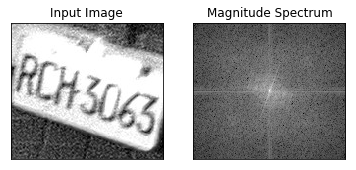

img3/KPA0288_3.jpg
(88, 168)


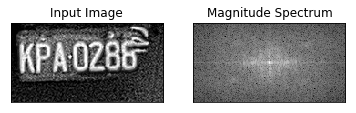

img3/3199S9_11.jpg
(72, 140)


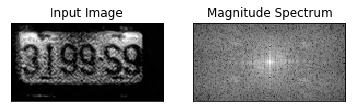

img3/KPA0288_7.jpg
(88, 176)


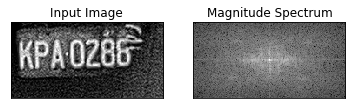

img3/3199S9_3.jpg
(68, 140)


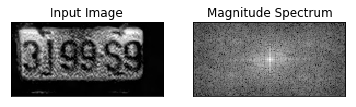

img3/3199S9_2.jpg
(68, 140)


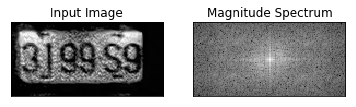

img3/KPA0288_4.jpg
(88, 176)


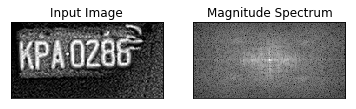

In [62]:
import pandas as pd
import os, sys
import numpy as np
import math
from matplotlib import pyplot as plt
from IPython.display import display
from PIL import Image
import PIL
import s3fs 
from sklearn import datasets,linear_model
import cv2
import time
isPlot=True
isBias=True


def looAll(path):
    lpRect_s=[]
    pix_gray_s=[]
    imWrap_s=[]
    imWrap_t_wrap_t_s=[]
    imWrap_t_wrap_t_scaled_s=[]
    lpCount=0
    for root,unkown,fNames in os.walk(path):
        for f in fNames:
            lpCount=lpCount+1
            strFpath="{}/{}".format(path,f)
            print(strFpath)
            fftplot(strFpath)

looAll('img3')
#%lprun -f looAll('img')


147
(116, 118)
(200, 58)
58


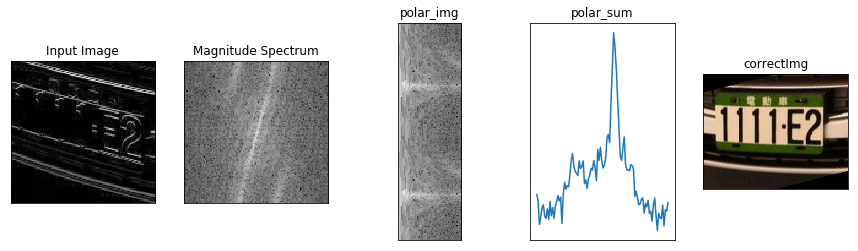

117
(146, 94)
(200, 47)
50


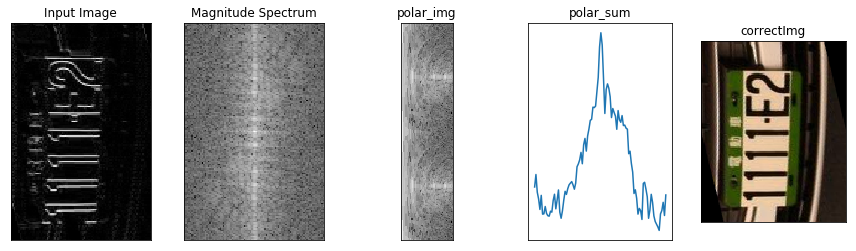

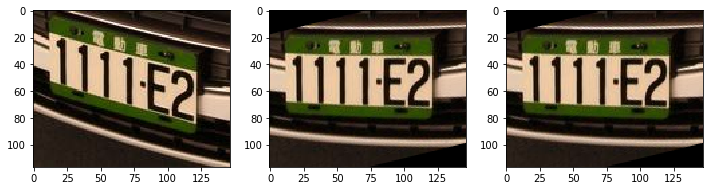

147
(116, 118)
(200, 58)
58


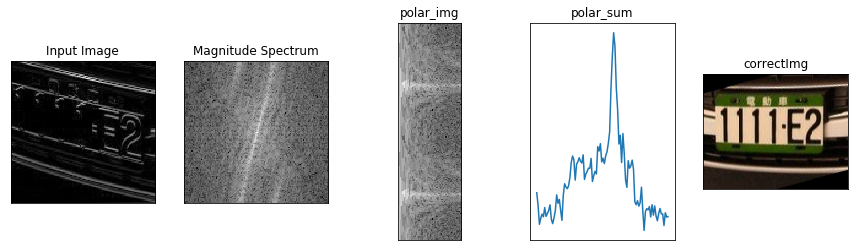

117
(146, 94)
(200, 47)
50


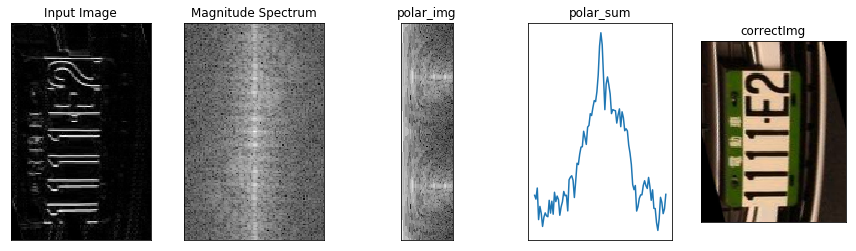

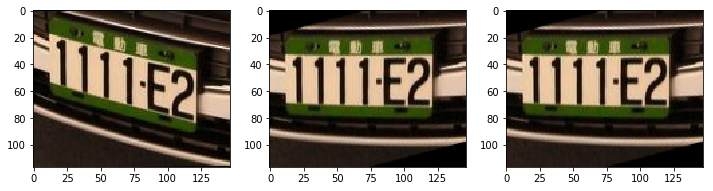

147
(116, 118)
(200, 58)
57


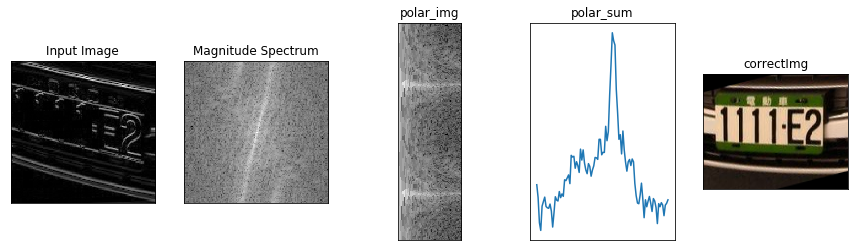

117
(146, 94)
(200, 47)
50


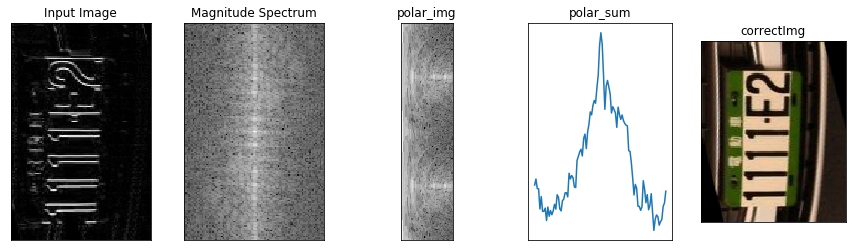

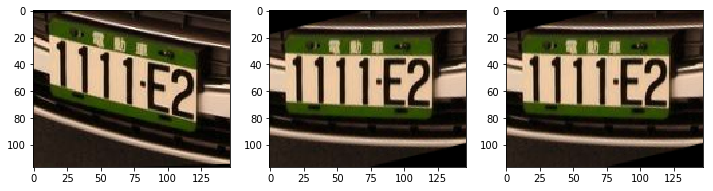

147
(116, 118)
(200, 58)
57


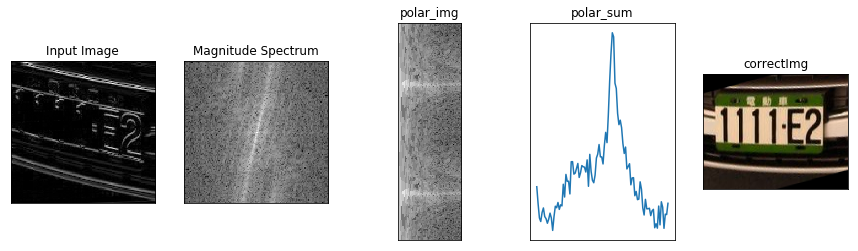

117
(146, 94)
(200, 47)
50


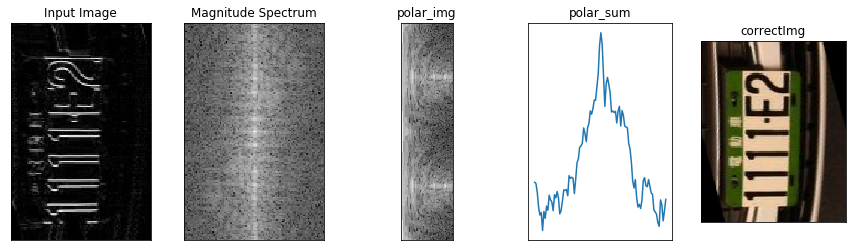

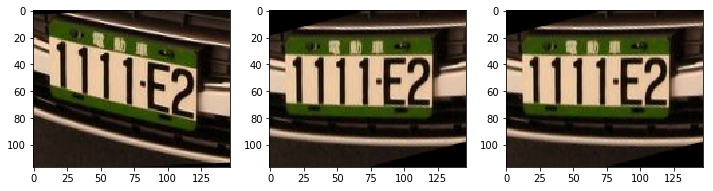

147
(116, 118)
(200, 58)
56


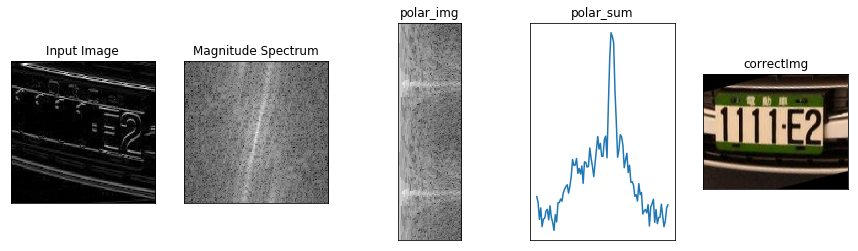

117
(146, 94)
(200, 47)
50


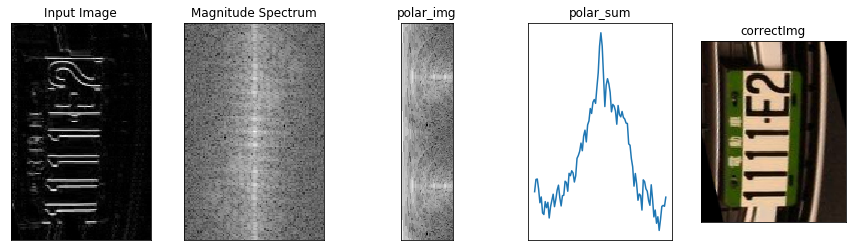

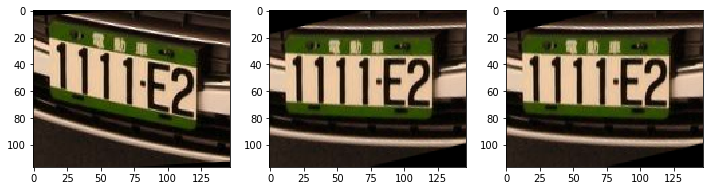

147
(116, 118)
(200, 58)
56


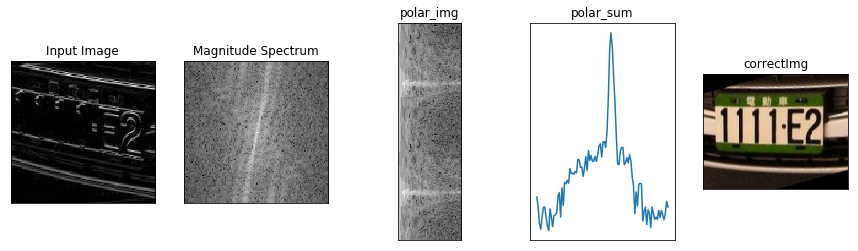

117
(146, 94)
(200, 47)
50


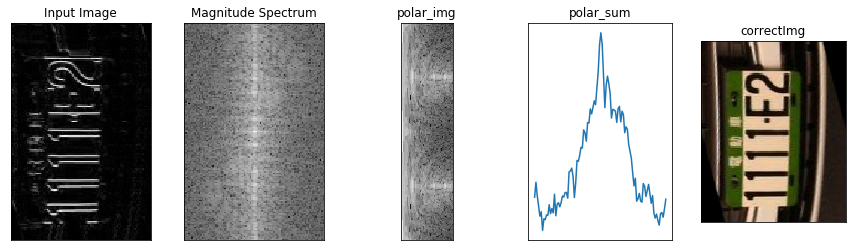

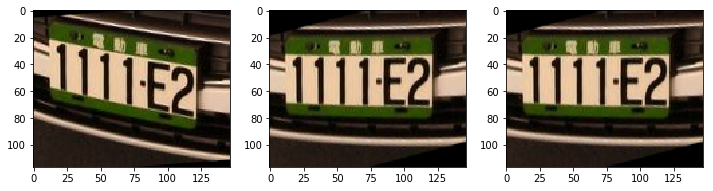

147
(116, 118)
(200, 58)
55


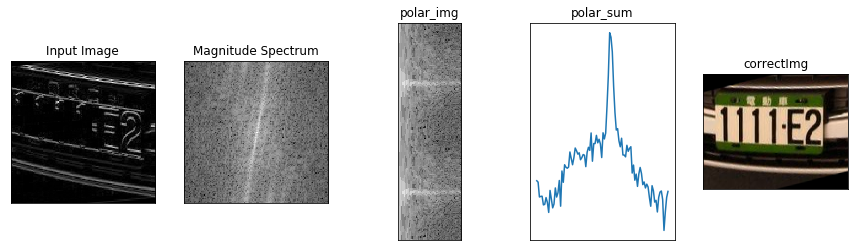

117
(146, 94)
(200, 47)
50


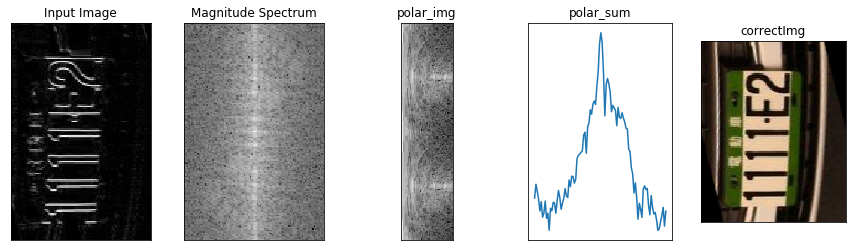

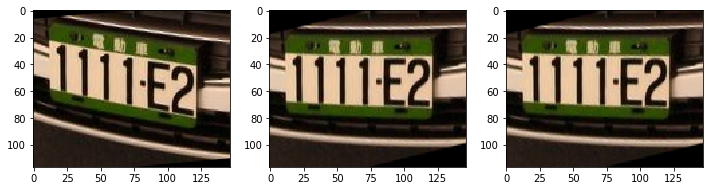

147
(116, 118)
(200, 58)
55


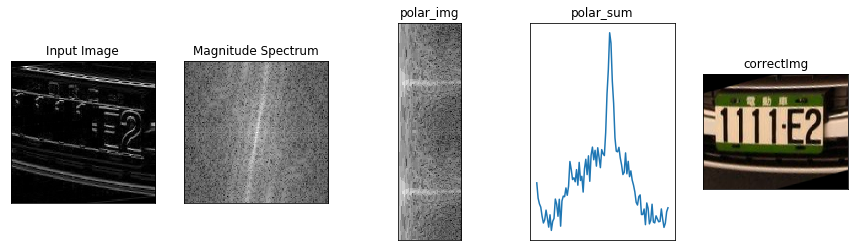

117
(146, 94)
(200, 47)
50


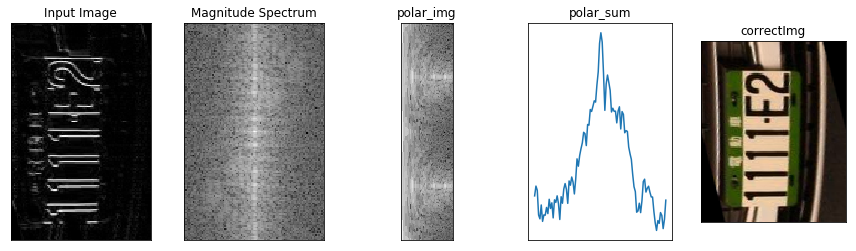

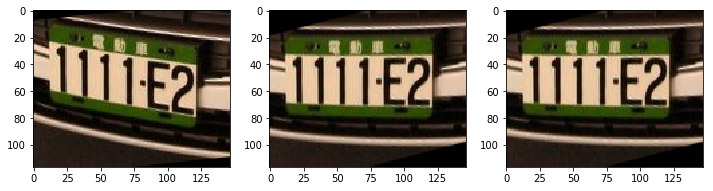

147
(116, 118)
(200, 58)
54


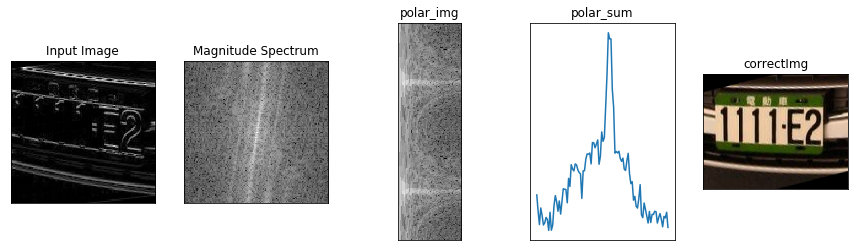

117
(146, 94)
(200, 47)
50


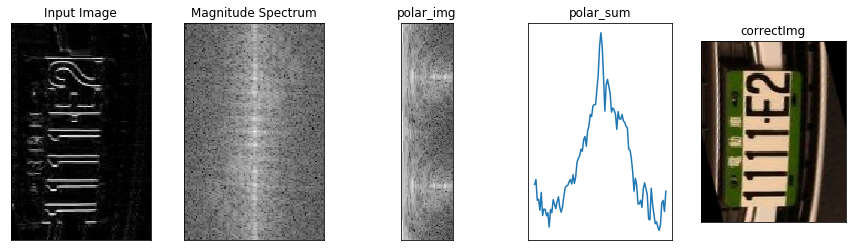

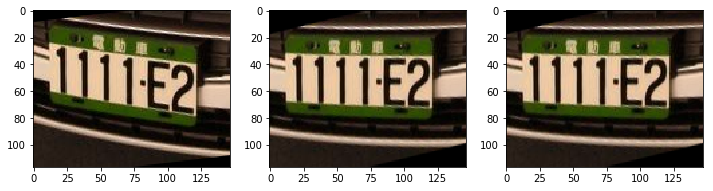

147
(116, 118)
(200, 58)
54


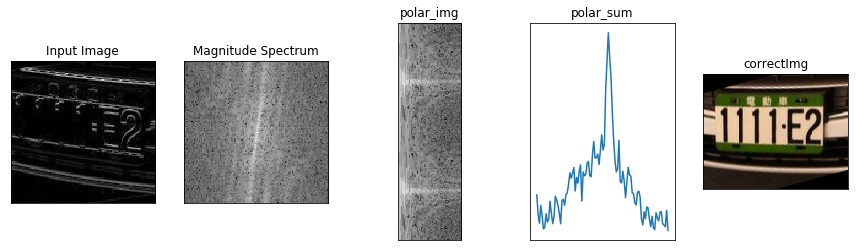

117
(146, 94)
(200, 47)
50


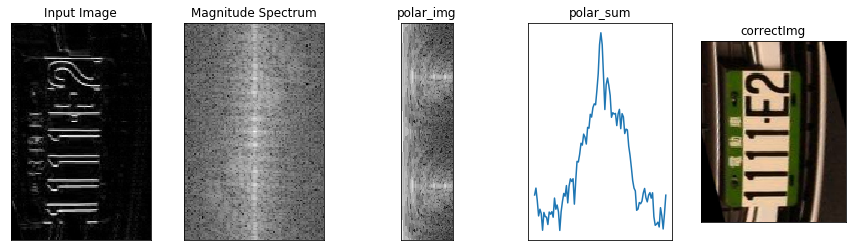

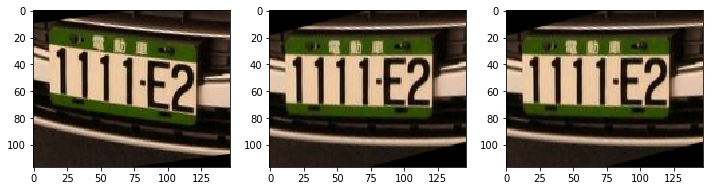

147
(116, 118)
(200, 58)
53


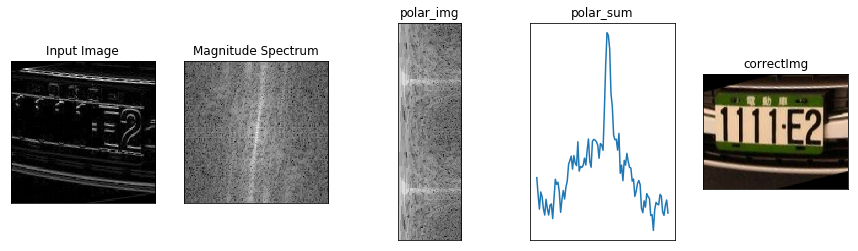

117
(146, 94)
(200, 47)
50


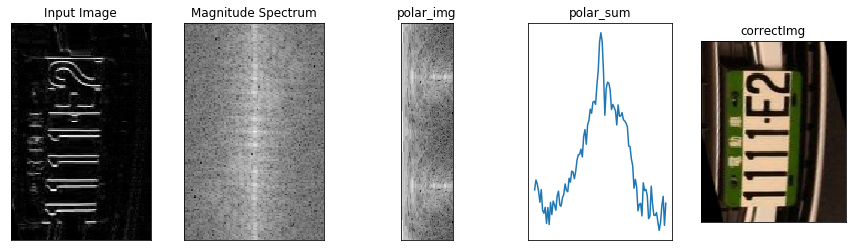

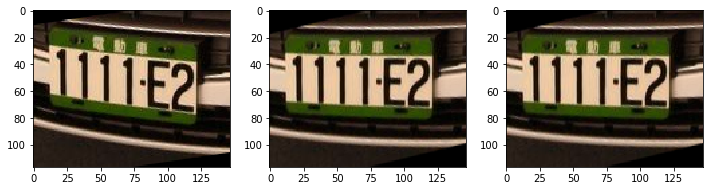

147
(116, 118)
(200, 58)
53


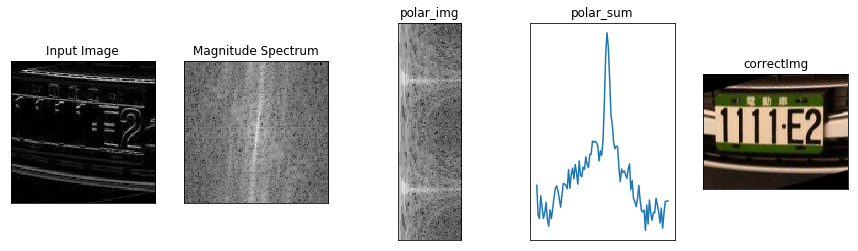

117
(146, 94)
(200, 47)
50


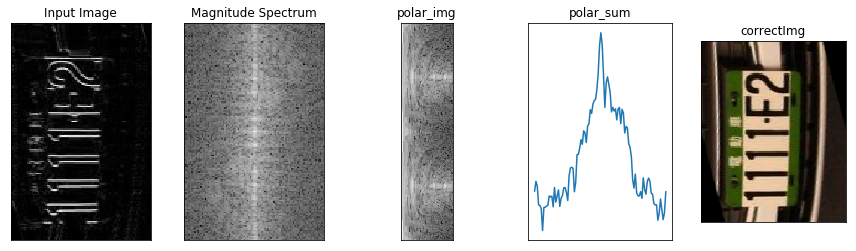

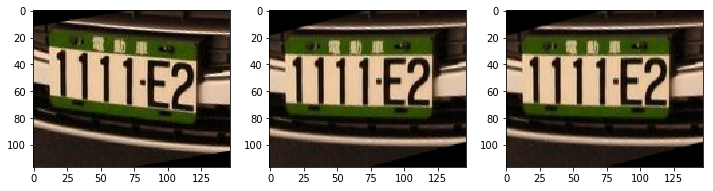

147
(116, 118)
(200, 58)
53


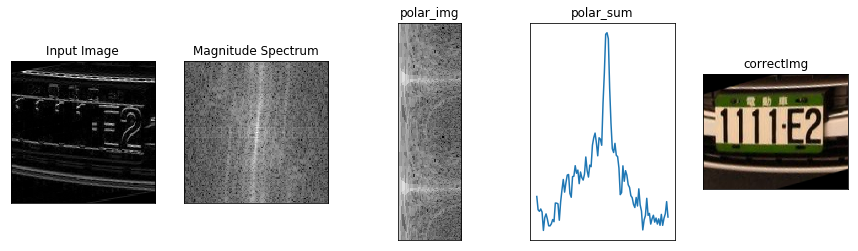

117
(146, 94)
(200, 47)
50


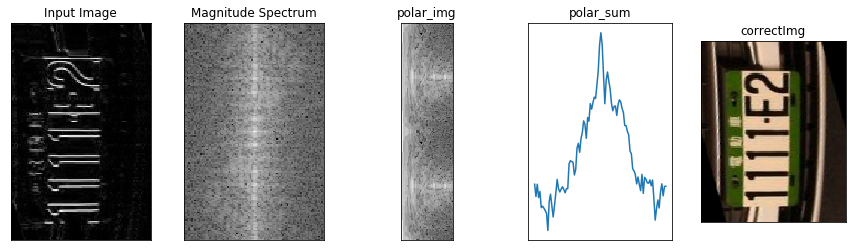

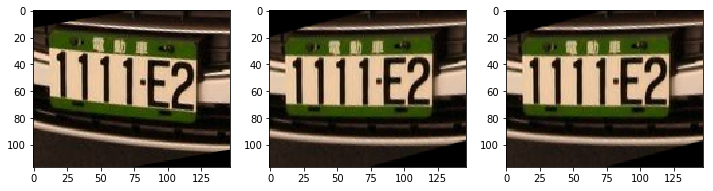

147
(116, 118)
(200, 58)
52


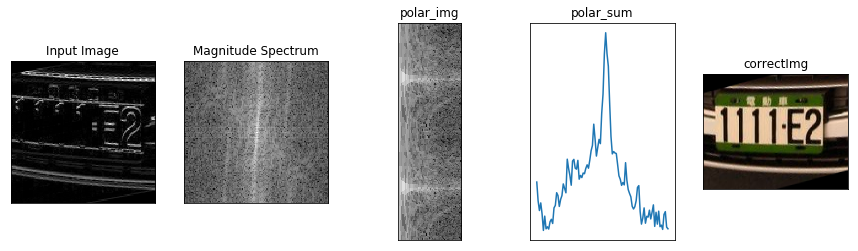

117
(146, 94)
(200, 47)
50


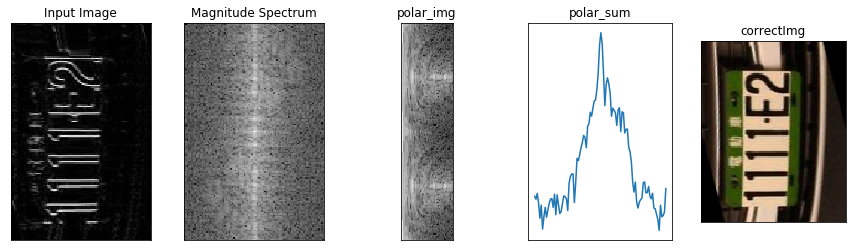

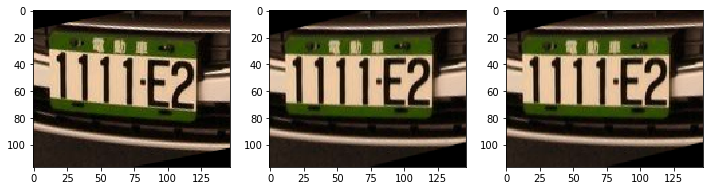

147
(116, 118)
(200, 58)
52


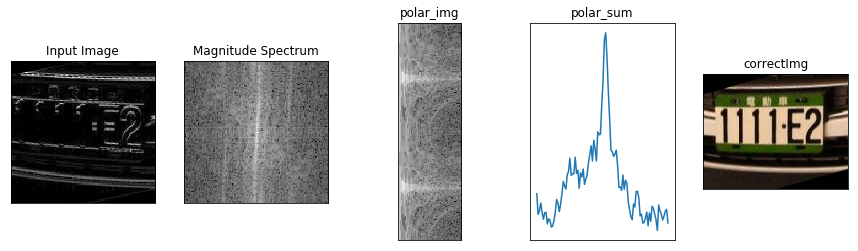

117
(146, 94)
(200, 47)
50


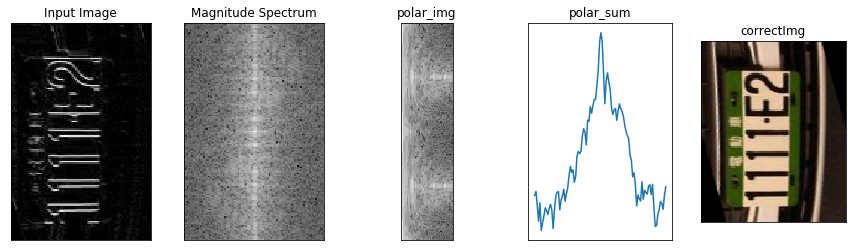

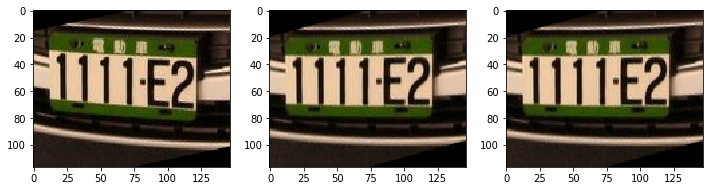

147
(116, 118)
(200, 58)
51


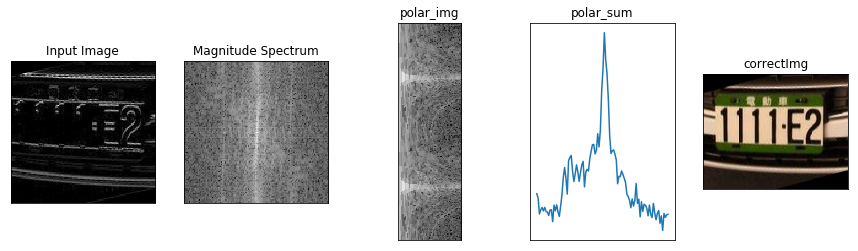

117
(146, 94)
(200, 47)
50


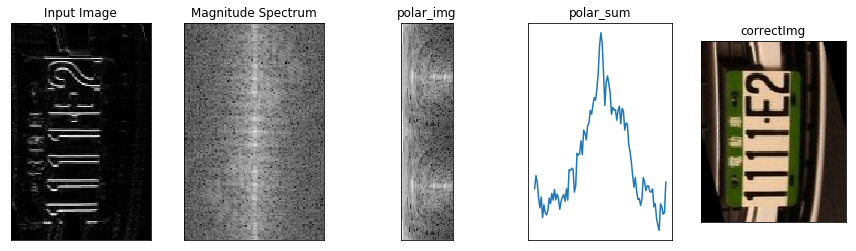

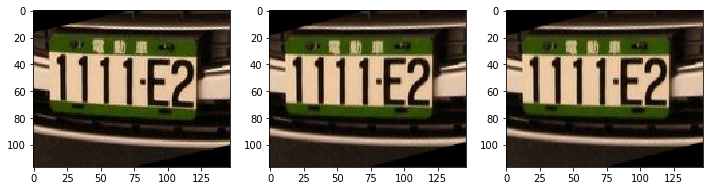

147
(116, 118)
(200, 58)
50


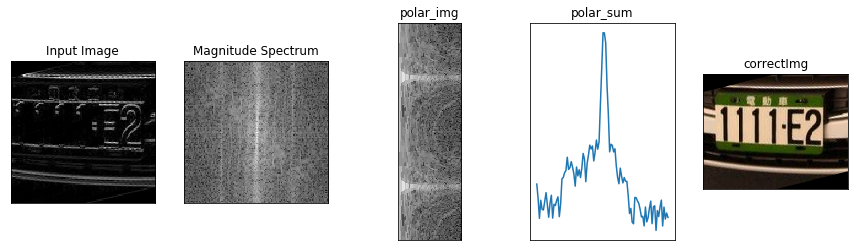

117
(146, 94)
(200, 47)
50


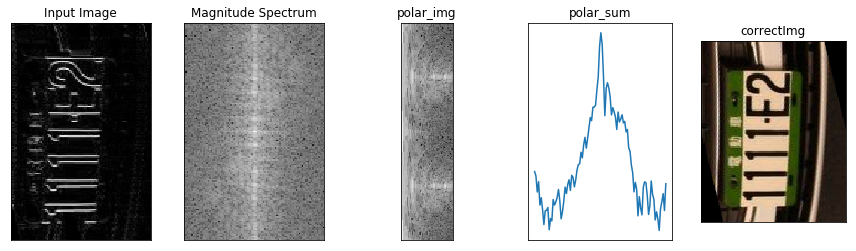

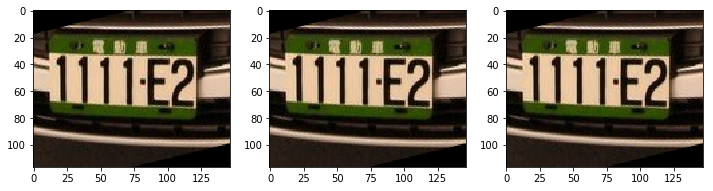

147
(116, 118)
(200, 58)
50


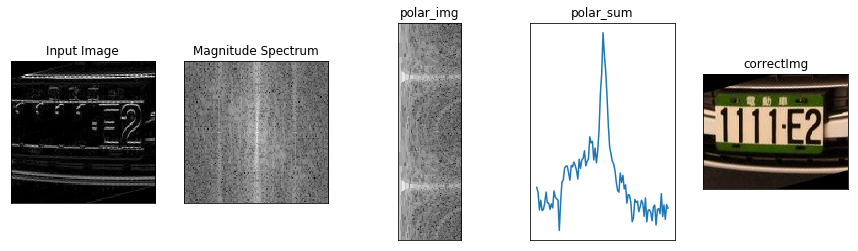

117
(146, 94)
(200, 47)
50


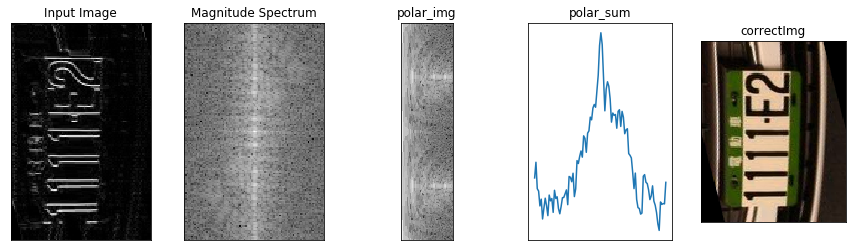

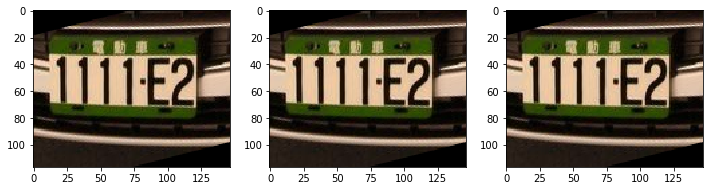

147
(116, 118)
(200, 58)
50


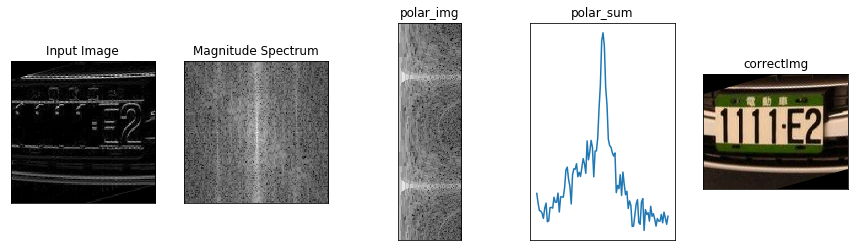

117
(146, 94)
(200, 47)
50


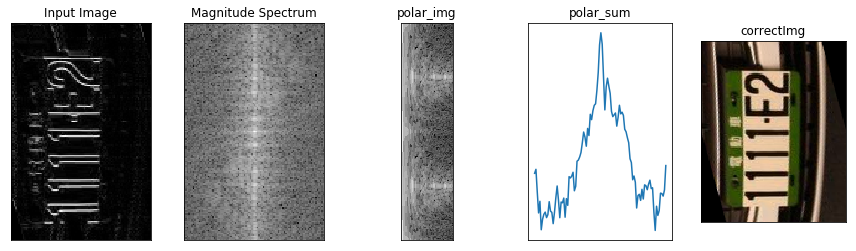

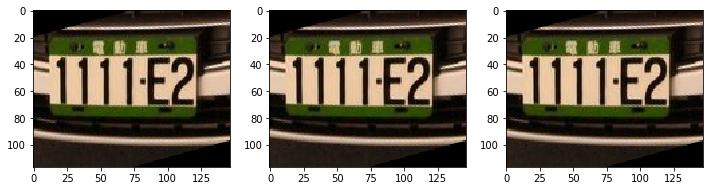

147
(116, 118)
(200, 58)
49


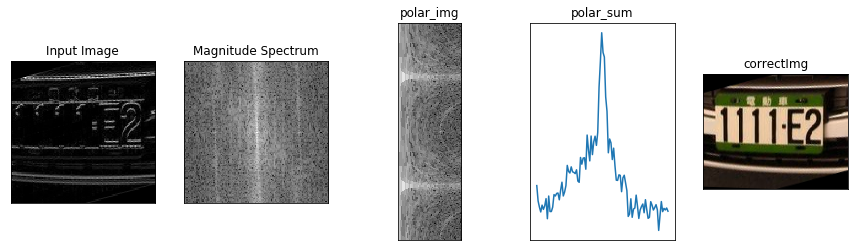

117
(146, 94)
(200, 47)
50


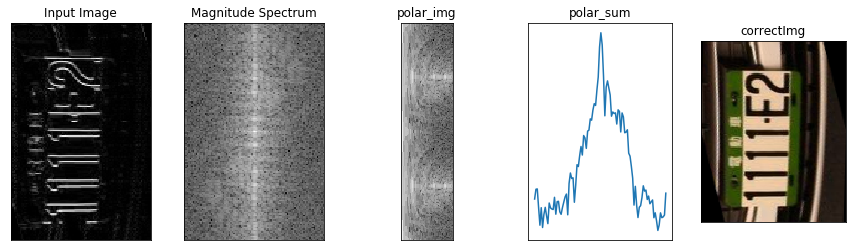

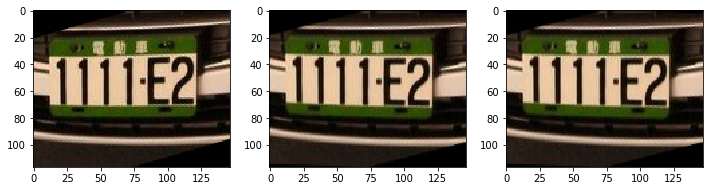

147
(116, 118)
(200, 58)
48


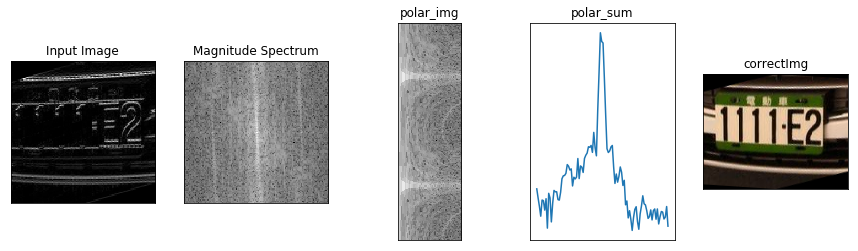

117
(146, 94)
(200, 47)
50


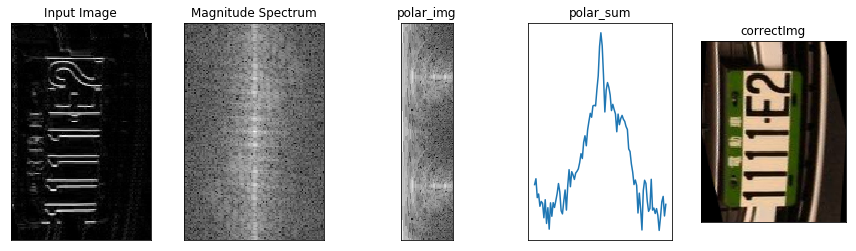

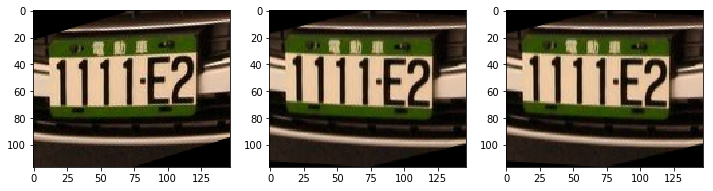

In [81]:
import pandas as pd
import os, sys
import numpy as np
import math
from matplotlib import pyplot as plt
from IPython.display import display
from PIL import Image
import PIL
import s3fs 
from sklearn import datasets,linear_model
import cv2
import time
import statistics
isPlot=True
isBias=False


src="img/0_1111E2_1.jpg"
#src="img4/MXN1053_1.jpg"
a=0.30459184
isPlot=True
GAIN=[1, 0.98, 0.89 ,0.72 ,0.55, 0.5, 0.55, 0.72, 0.89, 0.98, 1.0]

def rgb2gray(rgb):
    return np.dot(rgb[...,:3], [0.2989, 0.5870, 0.1140])


def imgWrapA(orgImg,a):
    column=orgImg.shape[1]
    row=orgImg.shape[0]
    #plt.plot( int(column/2),int(row/2),'rx')#fix
    #plt.plot( int(column/2),int(row/4),'bx')#fix
    #plt.plot( int(column/4),int(row/2-column/4*a),'go')#offset
    pts1 = np.float32([[column/2,row/2],[column/2,row/4],[column/4,row/2-column/4*a]])
    pts2 = np.float32([[column/2,row/2],[column/2,row/4],[column/4,row/2]])
    M = cv2.getAffineTransform(pts1,pts2)
    imgWarpAffine = cv2.warpAffine(orgImg,M,(column,row))
    return imgWarpAffine

def estCorrect(orgImg, cutoffF=0.8, margin=0.1):
    w=orgImg.shape[1]
    print(w)
    crop_img = orgImg[:, int(margin*w):int(w-margin*w)]
    pix_color = np.array(crop_img)
    full_pix_color = np.array(orgImg)
    img = rgb2gray(pix_color)
    img=abs(img[0:-1,:]-img[1:,:])
    
    print(img.shape)
    f = np.fft.fft2(img)
    fshift = np.fft.fftshift(f)
    magnitude_spectrum = 20*np.log(np.abs(fshift))
        
    #plt.subplot(143),plt.imshow(np.abs(fshift), cmap = 'gray')
    #plt.title('np.abs(fshift)'), plt.xticks([]), plt.yticks([])
    margin = 0.9 # Cut off the outer 10% of the image
    # Do the polar rotation along 100 angular steps with a radius of 256 pixels.
    size=min(img.shape)
    polar_img = cv2.warpPolar(magnitude_spectrum, (int(size/2), 200), (img.shape[1]/2,img.shape[0]/2), 
                                  size*margin*0.5, cv2.WARP_POLAR_LINEAR)
    print(polar_img.shape)

    polar_img_lowF=polar_img[:,int(0.2*polar_img.shape[1]):int(cutoffF*polar_img.shape[1])]
    
    polar_sum_200=np.sum(polar_img_lowF,axis=1)
    polar_sum=polar_sum_200[0:100]+polar_sum_200[100:200]
    #polar_sum[50]=min(polar_sum) #matthew  do not count center line
    #print(statistics.stdev(polar_sum[25:75]))
    gainStdev=statistics.stdev(polar_sum[25:75])/10000
    if isBias:
        polar_sum[45:56]=(polar_sum[45:56]*GAIN*gainStdev+polar_sum[45:56]*(1-gainStdev))
    maxIndex=np.argmax(polar_sum[25:75])+25
    print(maxIndex)
    offsetDegree=(maxIndex-50)/100*3.14
    aEst=np.sin(offsetDegree)
    #correctImg=imgWrapA(pix_color,aEst)
    correctImg=imgWrapA(full_pix_color,aEst)
    #full_pix_color
    #polar_sum[25:75]=min(polar_sum) #matthew  do not count center line
    #maxIndex2=np.argmax(polar_sum)
    #print("maxIndex2={}".format(maxIndex2))
    
    if isPlot:
        plt.subplots(1,4,figsize=(15,4))
        plt.subplot(151),plt.imshow(img, cmap = 'gray')
        plt.title('Input Image'), plt.xticks([]), plt.yticks([])
        plt.subplot(152),plt.imshow(magnitude_spectrum, cmap = 'gray')
        plt.title('Magnitude Spectrum'), plt.xticks([]), plt.yticks([])
        plt.subplot(153),plt.imshow(polar_img, cmap = 'gray')
        plt.title('polar_img'), plt.xticks([]), plt.yticks([])
        plt.subplot(154),plt.plot(polar_sum)
        #print(polar_sum-min(polar_sum))
        plt.title('polar_sum'), plt.xticks([]), plt.yticks([])
        plt.subplot(155),plt.imshow(correctImg)
        plt.title('correctImg'), plt.xticks([]), plt.yticks([])
        plt.show()
    return correctImg

def estCorrect2D(orgImg, cutoffF=0.8, margin=0.1):
    hCorrectedImg=estCorrect(orgImg, cutoffF, margin)
    hCorrectedImg90=np.rot90(hCorrectedImg, )
    vCorrectedImg=estCorrect(hCorrectedImg90, cutoffF, margin)
    vCorrectedImg270=np.rot90(vCorrectedImg,  k=3)
    if isPlot:
        plt.subplots(1,3,figsize=(12,4))
        plt.subplot(131),plt.imshow(orgImg)
        plt.subplot(132),plt.imshow(hCorrectedImg)
        plt.subplot(133),plt.imshow(vCorrectedImg270)
        plt.show()
        
    
    return hCorrectedImg, vCorrectedImg270


def fftplotWarp(imgPath):
    orgImg = cv2.imread(imgPath)
    pix_color = np.array(orgImg)
    #img = rgb2gray(pix_color)
    for i in range(21):
        imgWarp=imgWrapA(pix_color,a*i/20)
        hCorrectedImg, CorrectedImg=estCorrect2D(imgWarp, 0.8, 0.1)

        
fftplotWarp(src)


img/0_4932XX_1.jpg
180
(186, 144)
(200, 72)
60


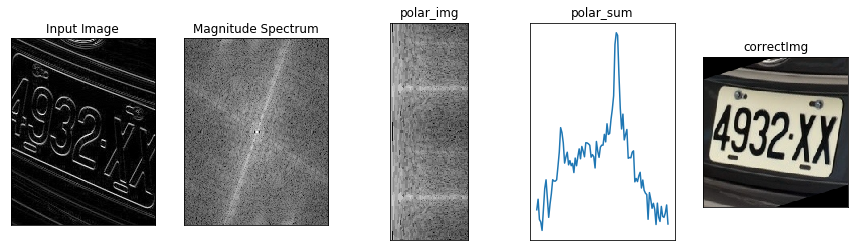

187
(179, 150)
(200, 75)
54


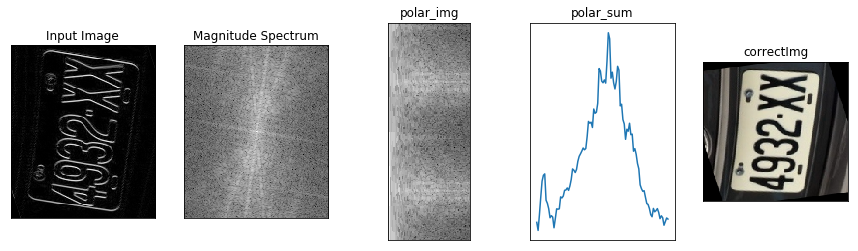

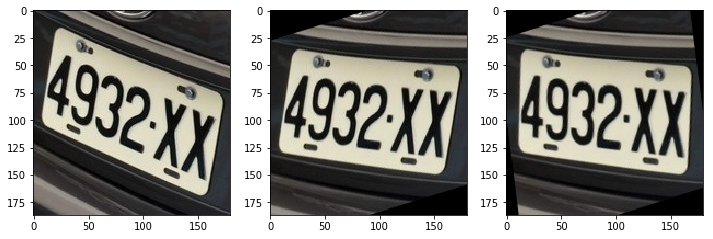

(187, 180, 3)
187
93
img/0_RAP1829_2.jpg
59
(57, 48)
(200, 24)
36


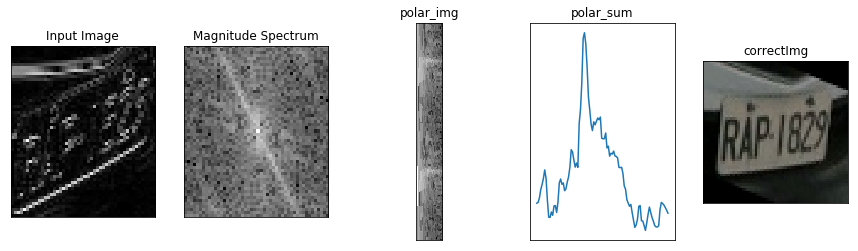

58
(58, 47)
(200, 23)
53


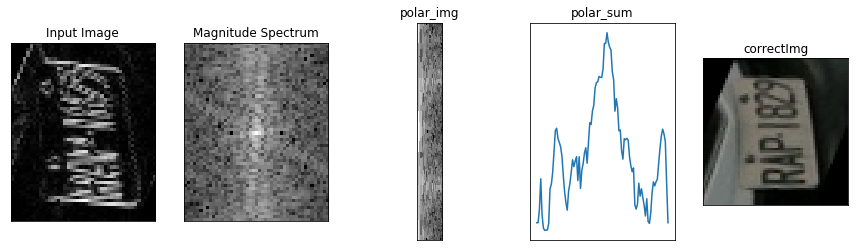

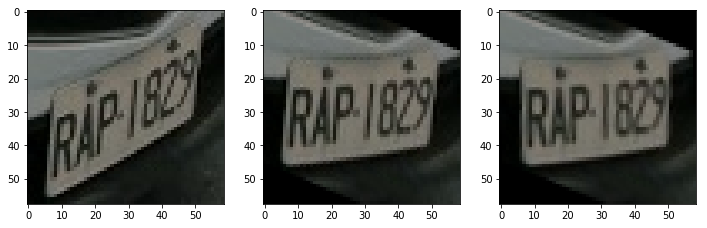

(58, 59, 3)
58
29
img/aqz3681.jpeg
96
(124, 77)
(200, 38)
53


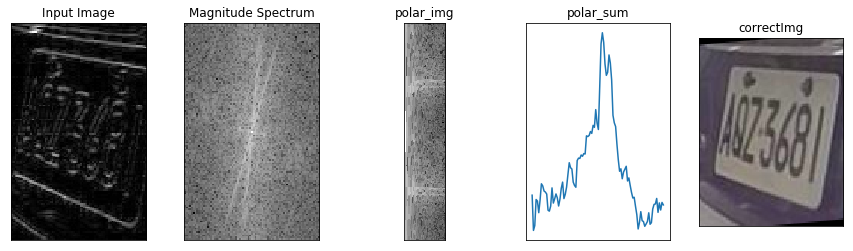

125
(95, 100)
(200, 47)
55


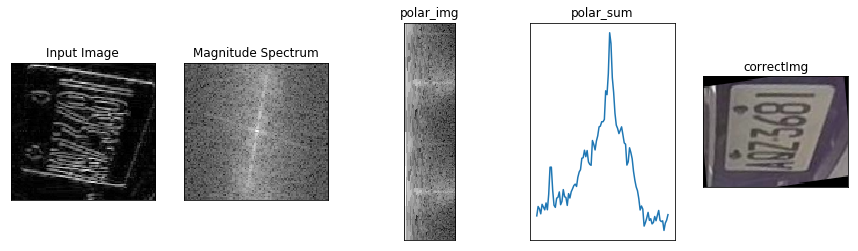

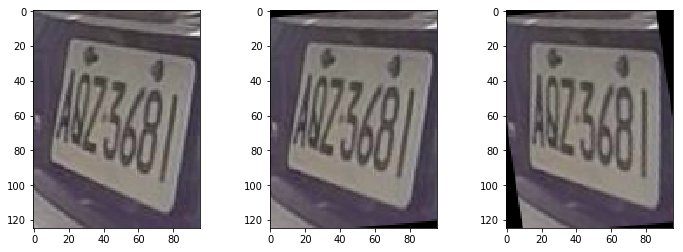

(125, 96, 3)
125
62
img/0_2326YG_2.jpg
59
(57, 48)
(200, 24)
62


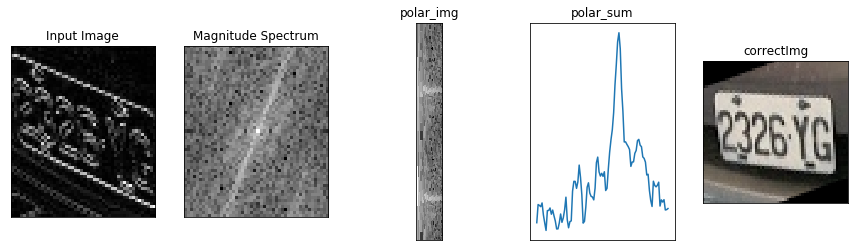

58
(58, 47)
(200, 23)
48


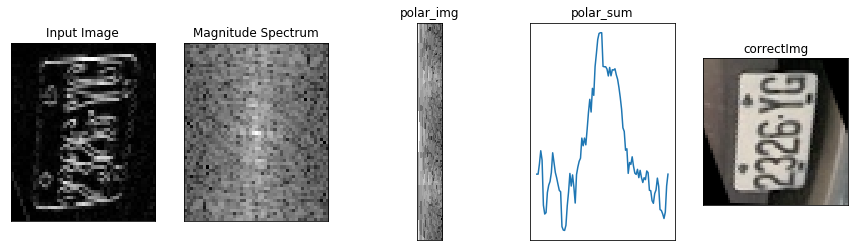

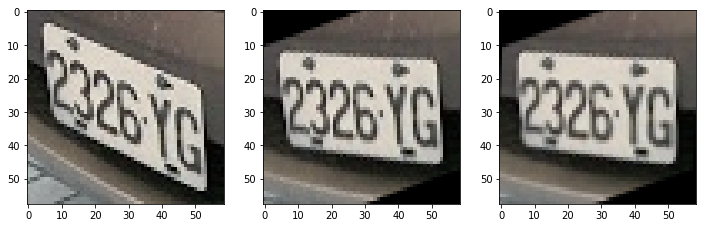

(58, 59, 3)
58
29
img/0_AFL3797_1.jpg
209
(164, 168)
(200, 82)
54


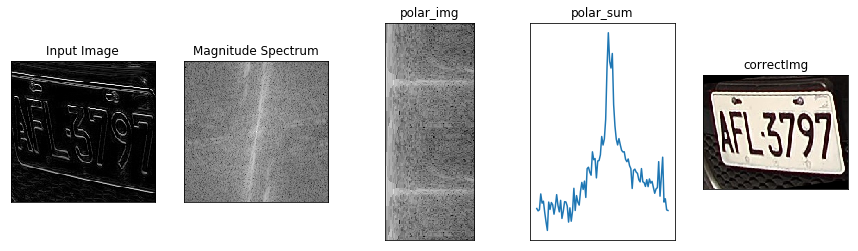

165
(208, 132)
(200, 66)
47


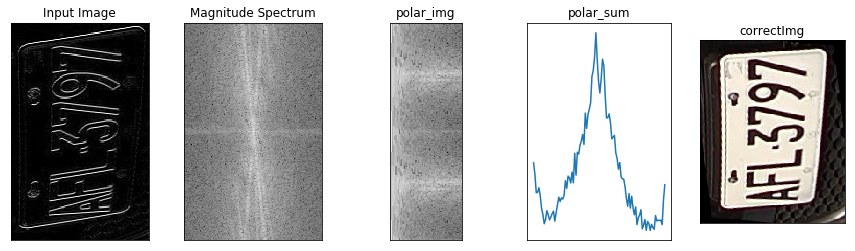

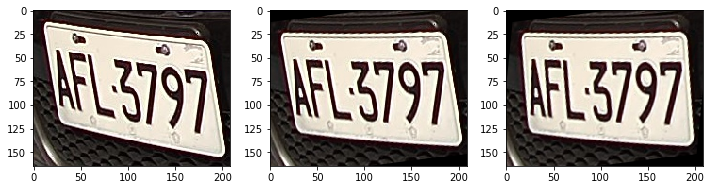

(165, 209, 3)
165
82
img/0_5790PD_1.jpg
63
(68, 50)
(200, 25)
40


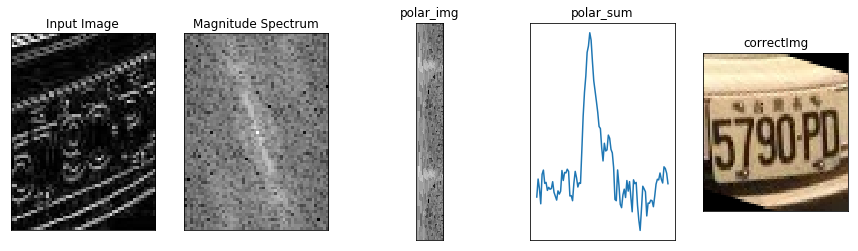

69
(62, 56)
(200, 28)
49


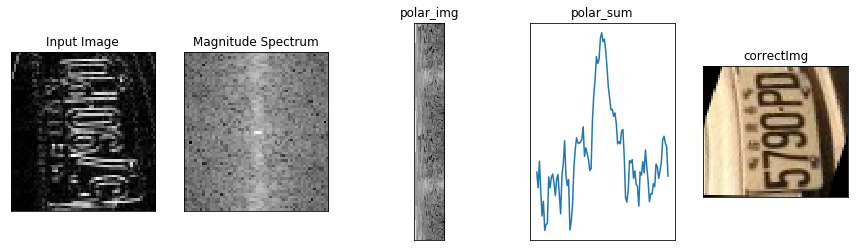

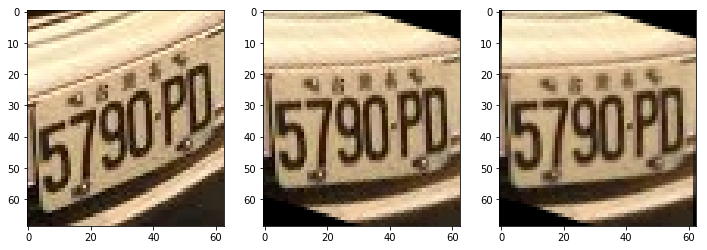

(69, 63, 3)
69
34
img/EMY0355_2.jpg
108
(71, 87)
(200, 35)
51


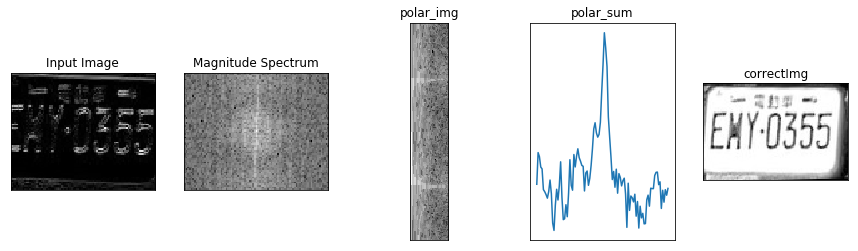

72
(107, 57)
(200, 28)
50


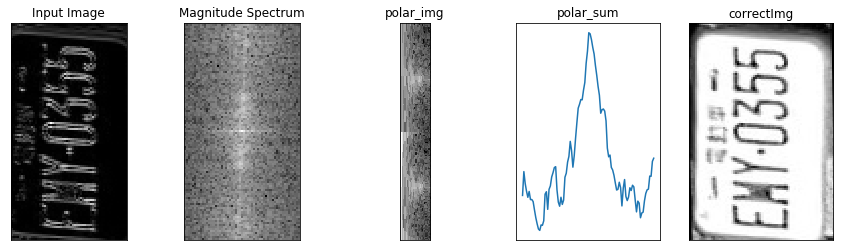

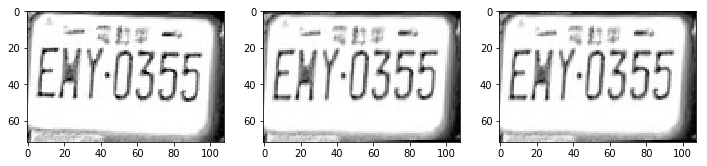

(72, 108, 3)
72
36
img/5876j9.jpeg
112
(108, 89)
(200, 44)
57


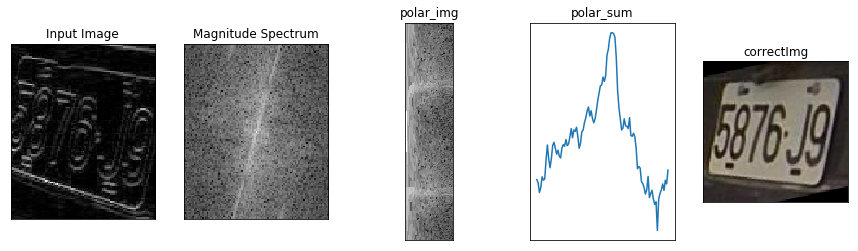

109
(111, 88)
(200, 44)
55


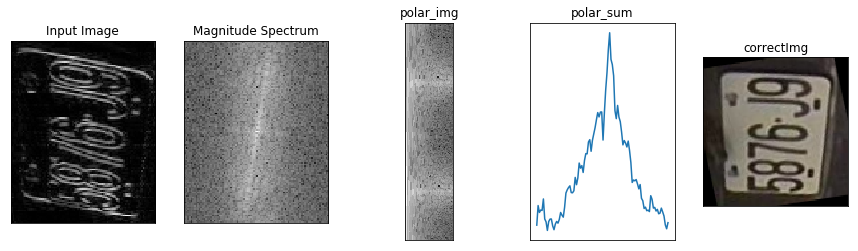

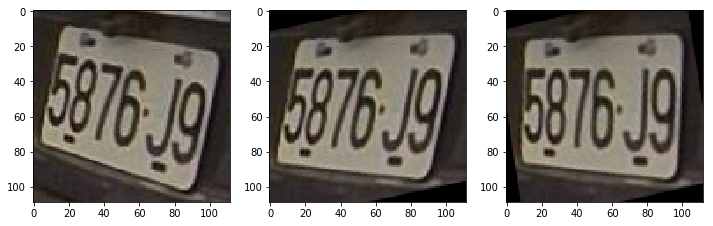

(109, 112, 3)
109
54
img/bbh1001.jpeg
93
(117, 74)
(200, 37)
52


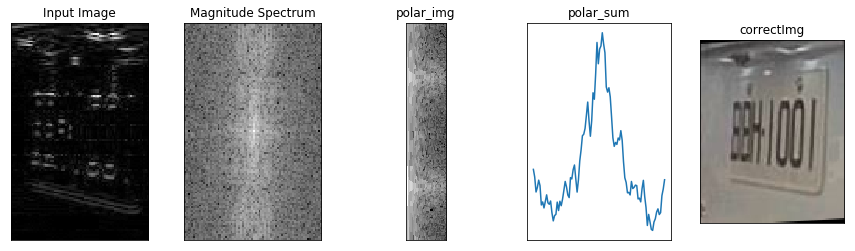

118
(92, 95)
(200, 46)
52


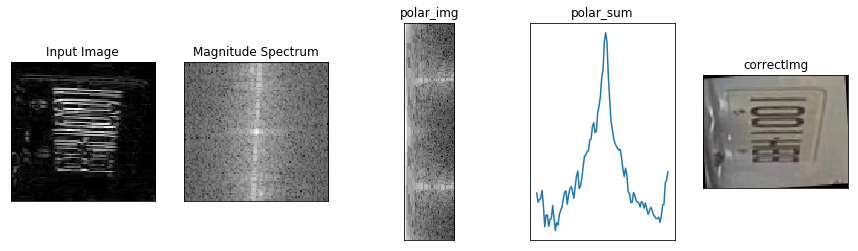

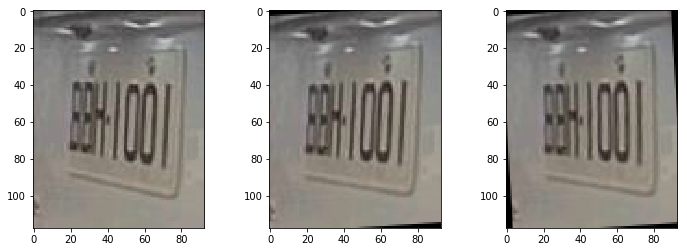

(118, 93, 3)
118
59
img/0_RCK3967_3.jpg
66
(48, 53)
(200, 24)
59


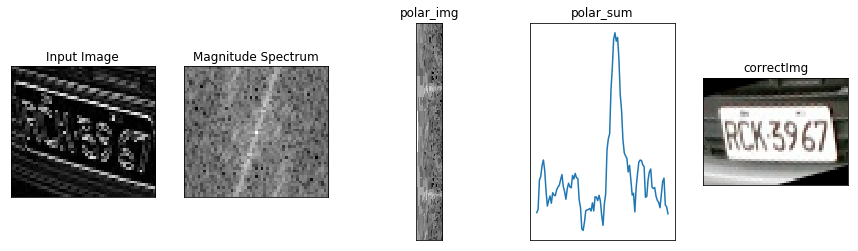

49
(65, 40)
(200, 20)
48


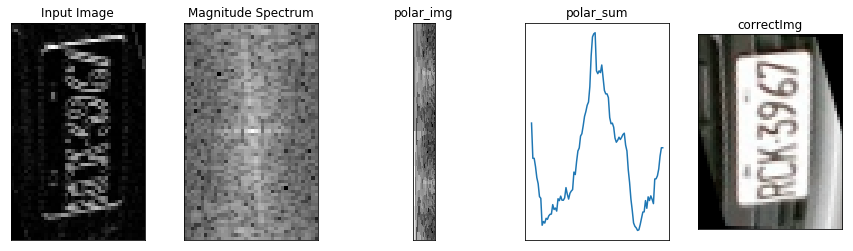

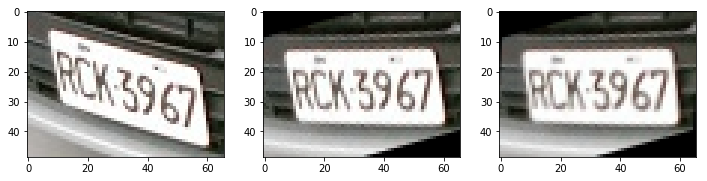

(49, 66, 3)
49
24
img/0_6603A9_1.jpg
135
(72, 108)
(200, 36)
48


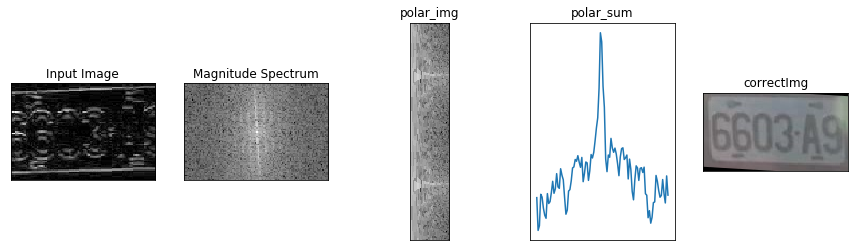

73
(134, 58)
(200, 29)
50


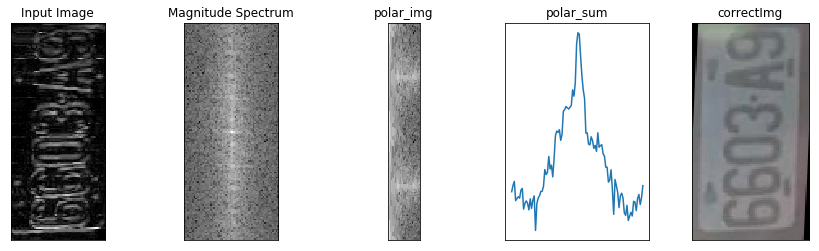

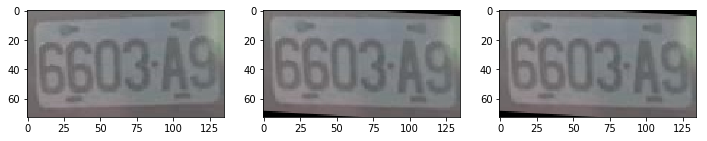

(73, 135, 3)
73
36
img/0_1111E2_1.jpg
147
(116, 118)
(200, 58)
58


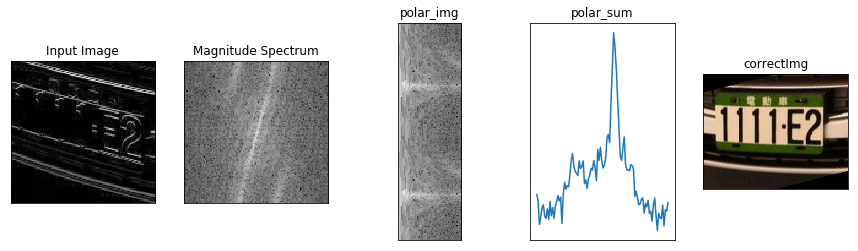

117
(146, 94)
(200, 47)
50


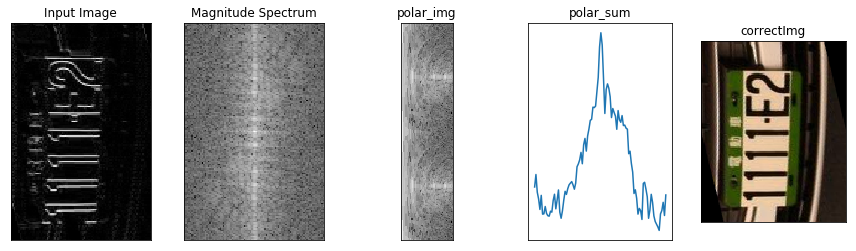

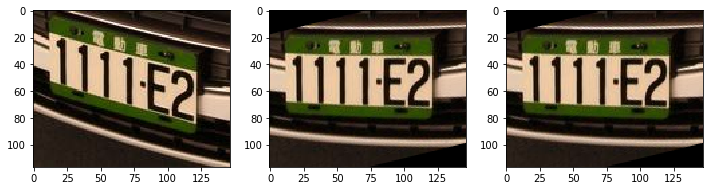

(117, 147, 3)
117
58
img/6992mj.jpeg
61
(92, 48)
(200, 24)
55


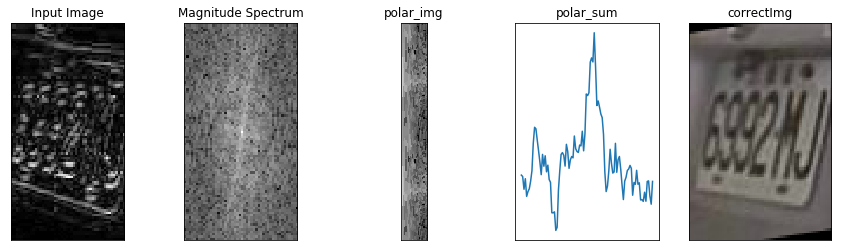

93
(60, 74)
(200, 30)
57


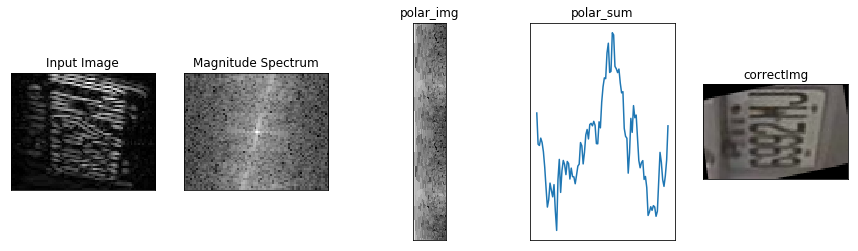

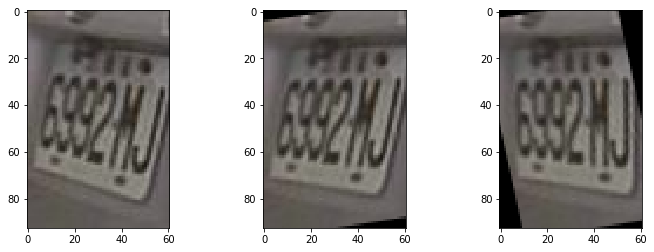

(93, 61, 3)
93
46
img/0_5478C7_1.jpg
107
(82, 86)
(200, 41)
56


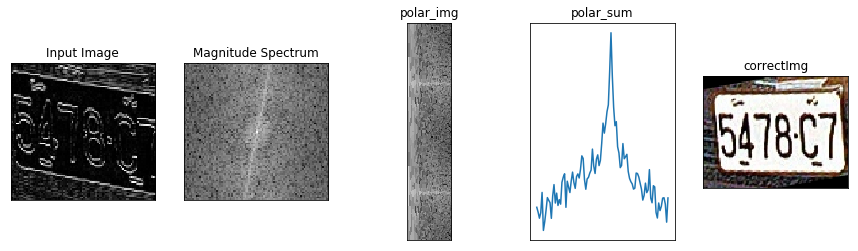

83
(106, 66)
(200, 33)
49


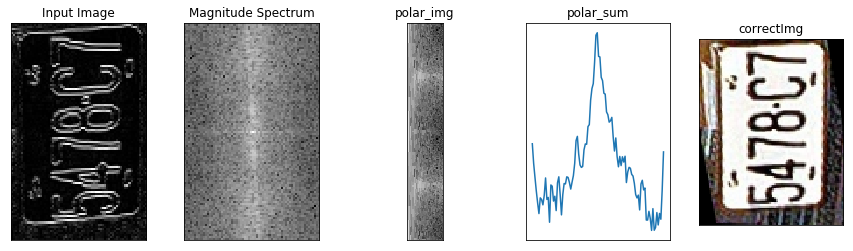

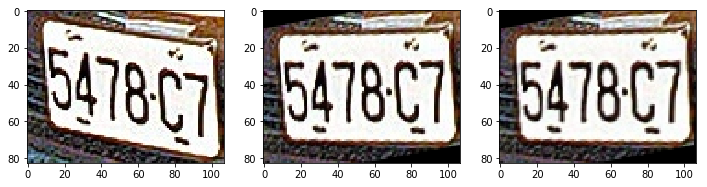

(83, 107, 3)
83
41
img/0_AQP8598_1.jpg
173
(85, 138)
(200, 42)
48


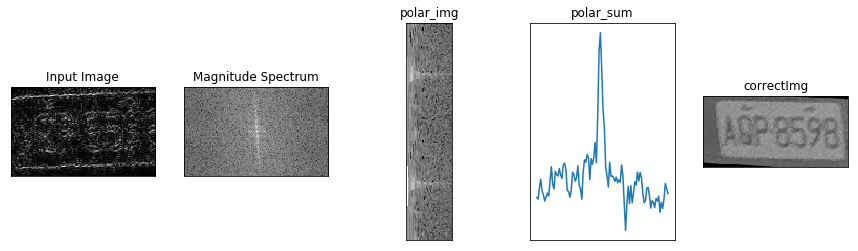

86
(172, 69)
(200, 34)
50


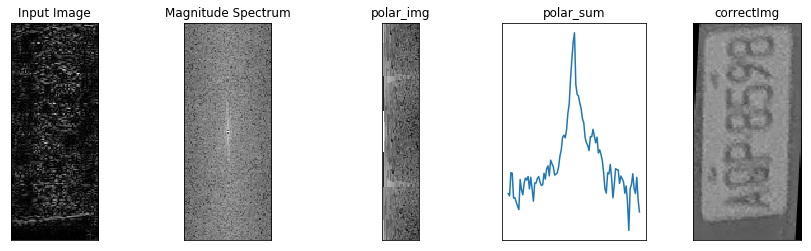

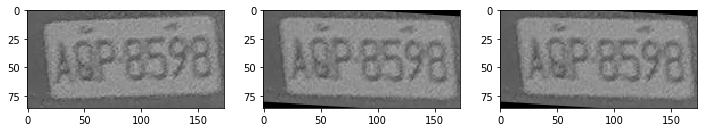

(86, 173, 3)
86
43
img/0_5180S5_1.jpg
81
(61, 64)
(200, 30)
62


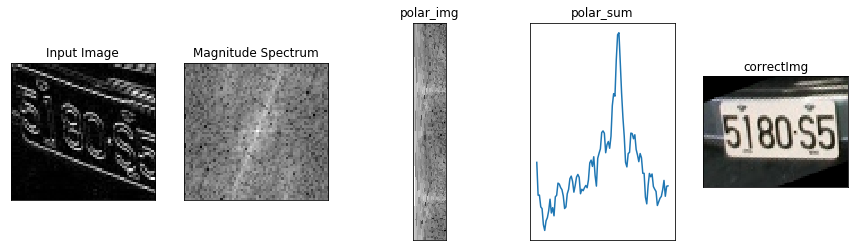

62
(80, 49)
(200, 24)
50


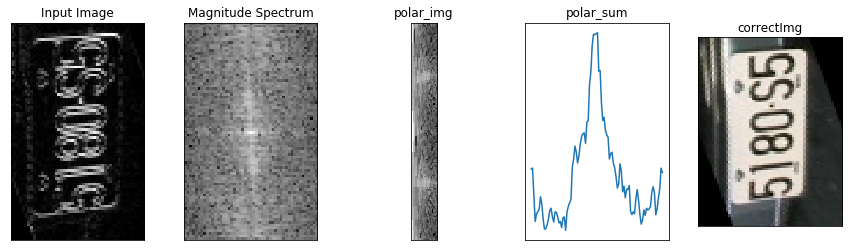

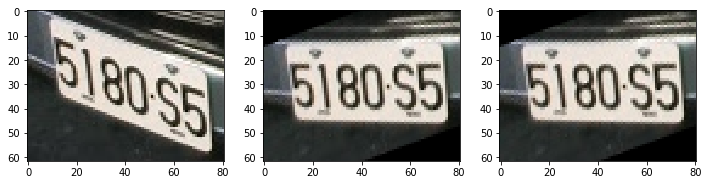

(62, 81, 3)
62
31
img/F7N060_1.jpg
120
(103, 96)
(200, 48)
53


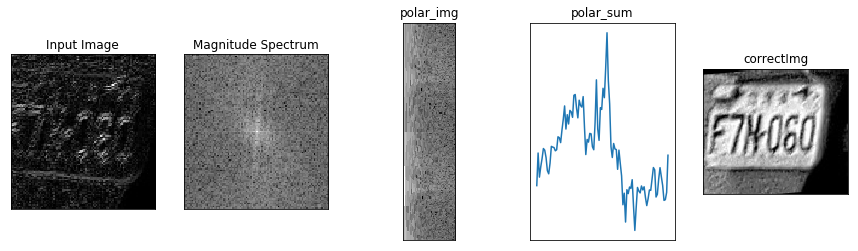

104
(119, 83)
(200, 41)
52


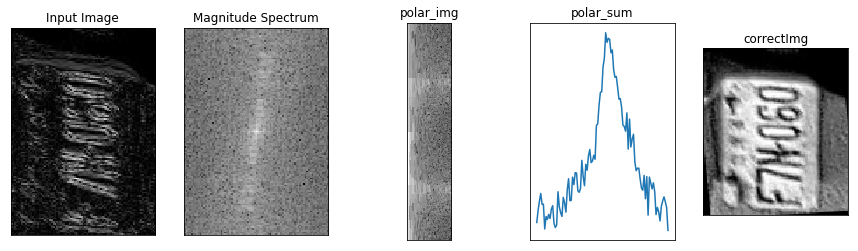

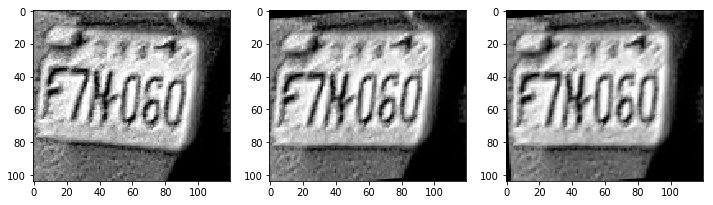

(104, 120, 3)
104
52
img/0_3903ES_3.jpg
143
(89, 114)
(200, 44)
43


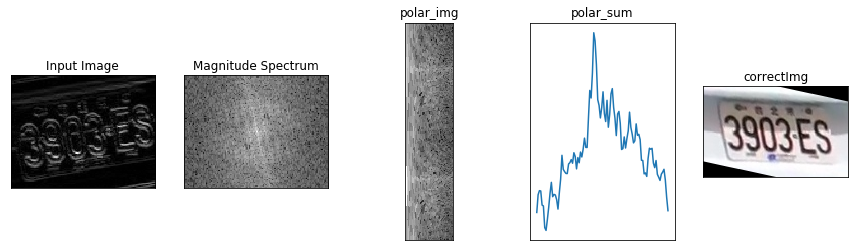

90
(142, 72)
(200, 36)
47


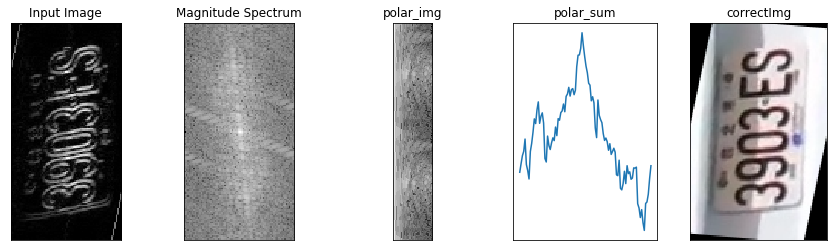

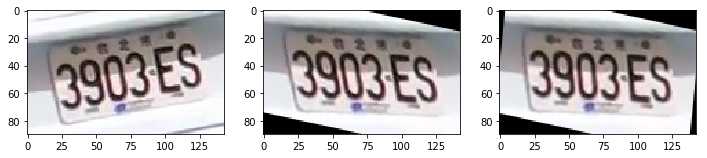

(90, 143, 3)
90
45
img/0_5168U9_1.jpg
70
(59, 56)
(200, 28)
35


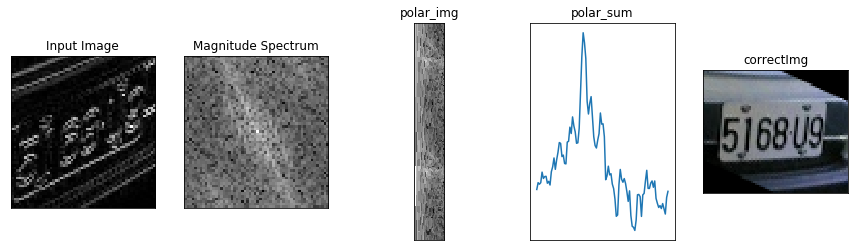

60
(69, 48)
(200, 24)
54


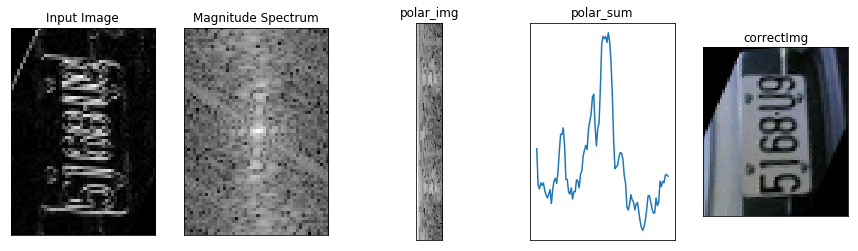

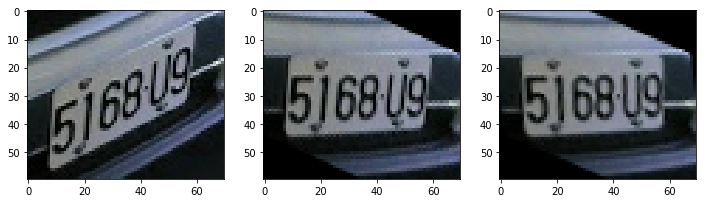

(60, 70, 3)
60
30
img/F7N060_2.jpg
120
(91, 96)
(200, 45)
51


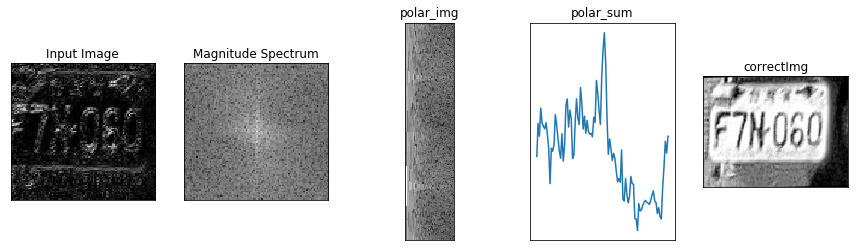

92
(119, 73)
(200, 36)
52


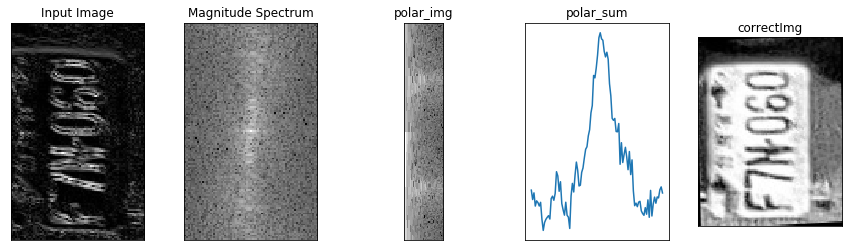

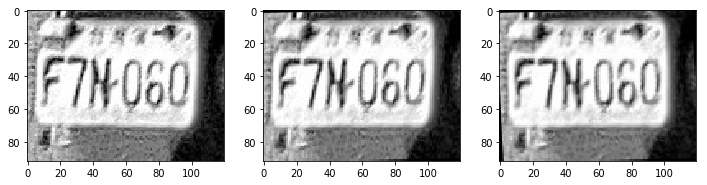

(92, 120, 3)
92
46
img/bey2986.jpeg
122
(92, 97)
(200, 46)
53


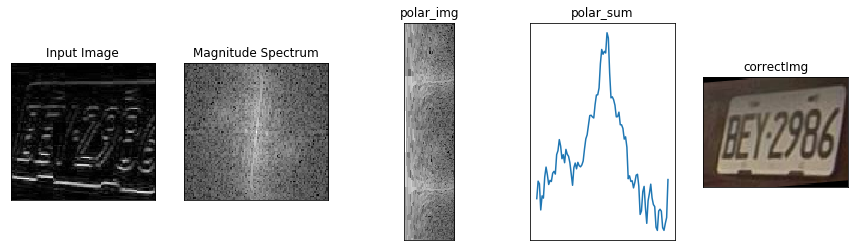

93
(121, 74)
(200, 37)
53


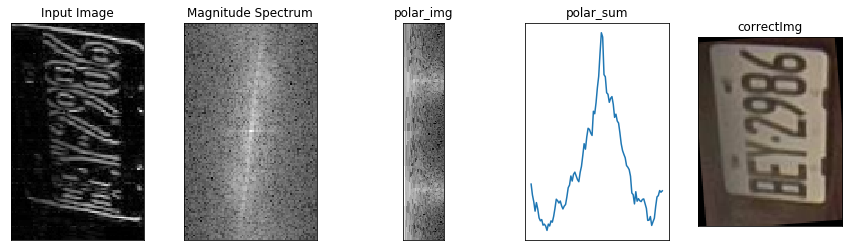

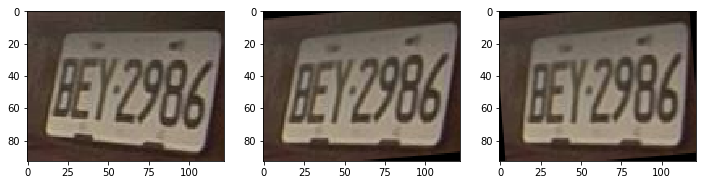

(93, 122, 3)
93
46
img/0_3903ES_2.jpg
172
(118, 137)
(200, 59)
42


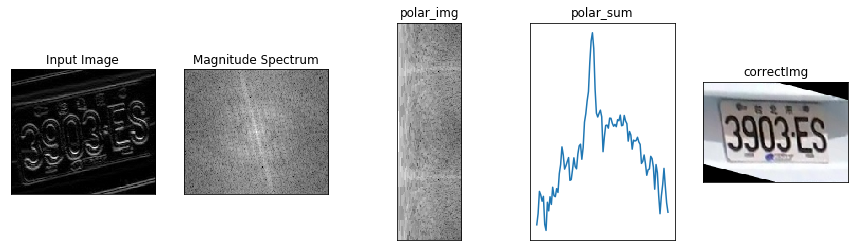

119
(171, 96)
(200, 48)
48


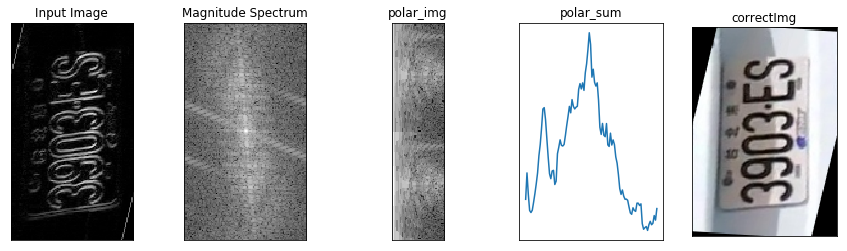

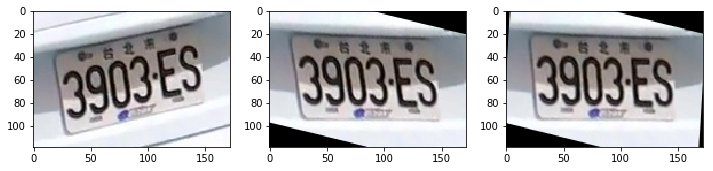

(119, 172, 3)
119
59
img/0_RAD9736_1.jpg
146
(77, 117)
(200, 38)
49


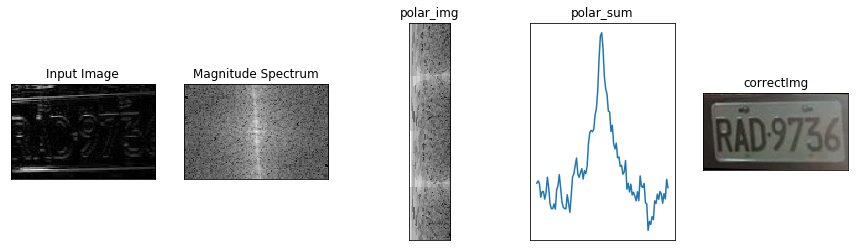

78
(145, 63)
(200, 31)
49


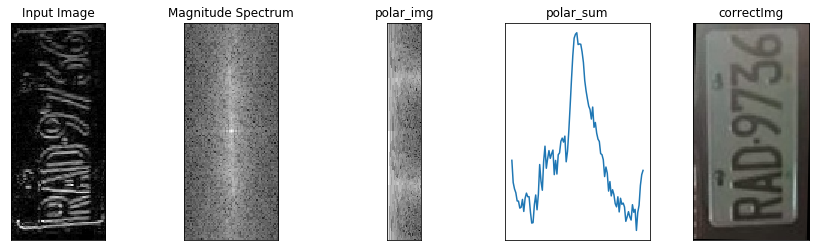

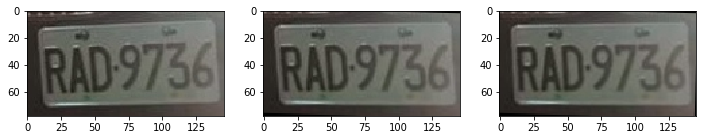

(78, 146, 3)
78
39
img/0_238KGR_1.jpg
72
(62, 57)
(200, 28)
38


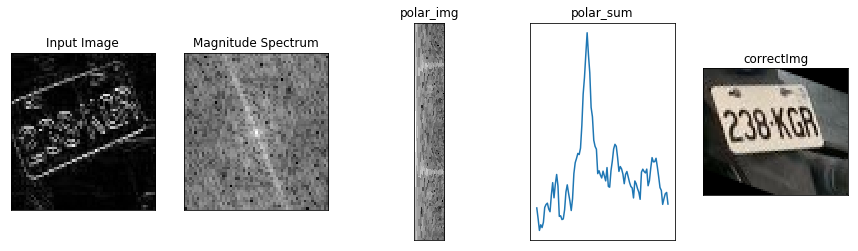

63
(71, 50)
(200, 25)
43


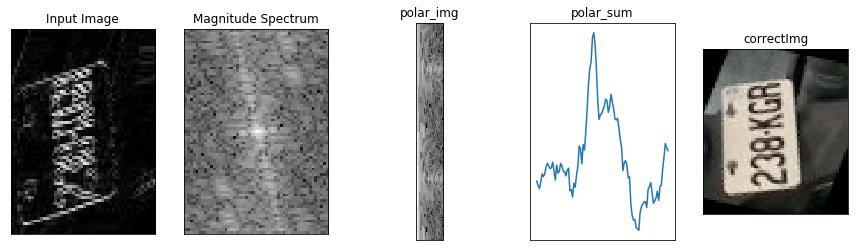

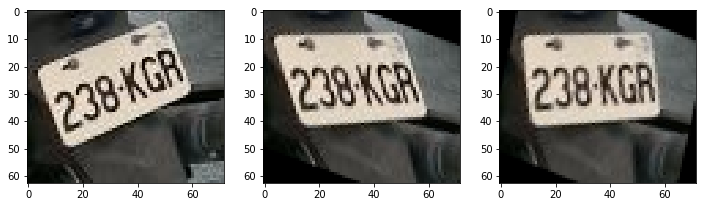

(63, 72, 3)
63
31
img/0_3903ES_1.jpg
162
(166, 129)
(200, 64)
38


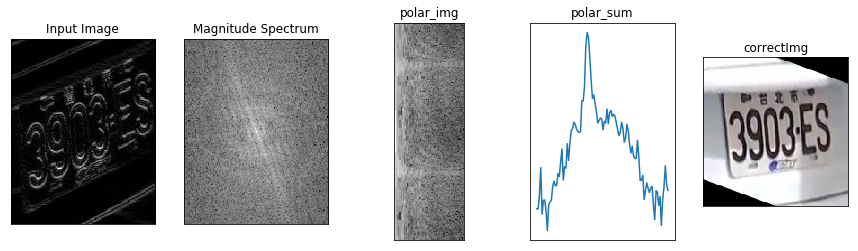

167
(161, 134)
(200, 67)
48


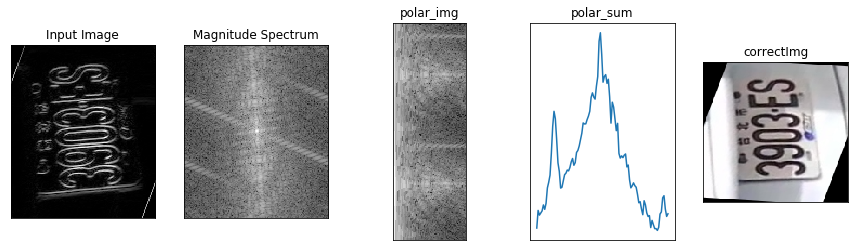

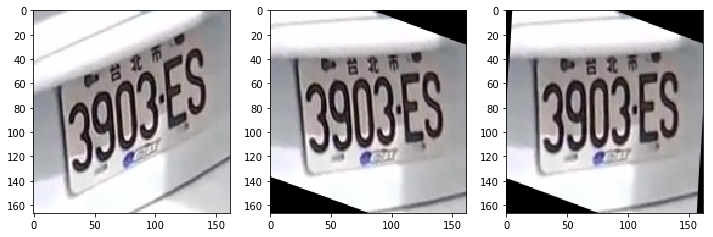

(167, 162, 3)
167
83
img/4258zx.jpeg
109
(98, 88)
(200, 44)
59


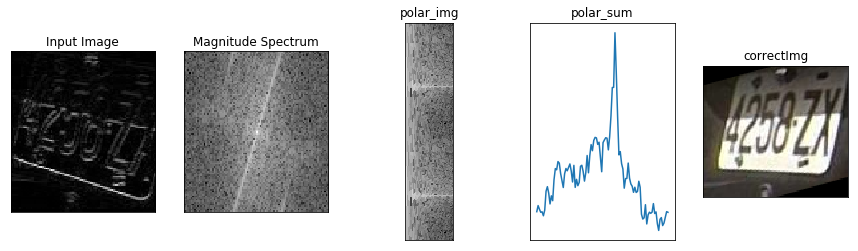

99
(108, 80)
(200, 40)
56


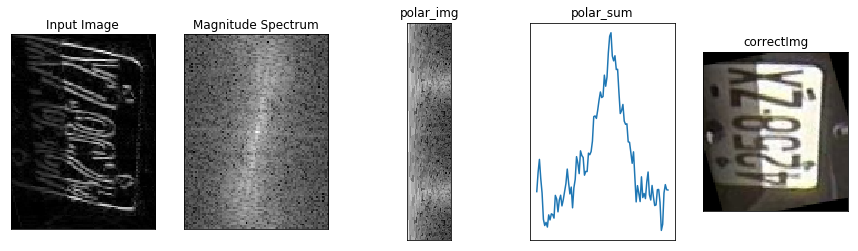

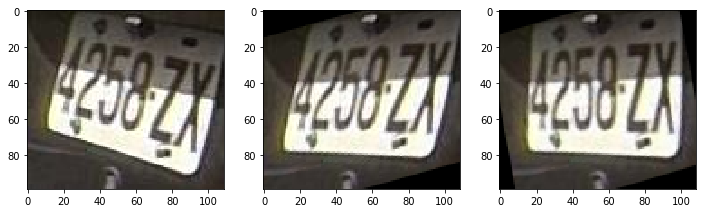

(99, 109, 3)
99
49
img/0_5567WK_1.jpeg
144
(90, 115)
(200, 45)
54


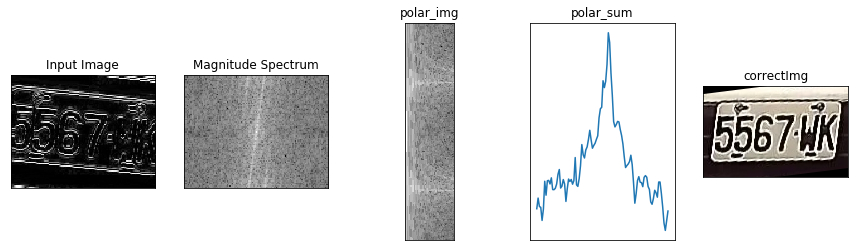

91
(143, 72)
(200, 36)
52


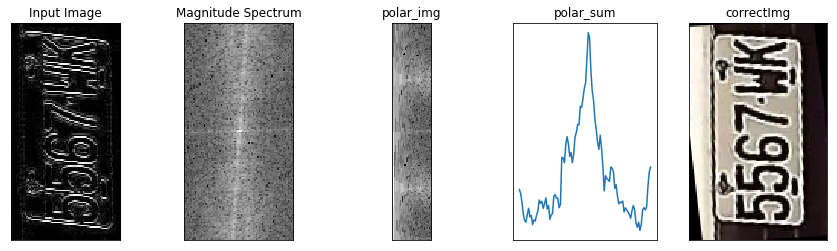

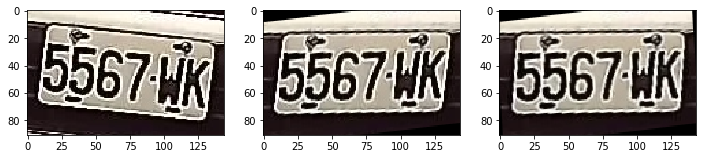

(91, 144, 3)
91
45
img/0_2326YG_1.jpg
66
(52, 53)
(200, 26)
35


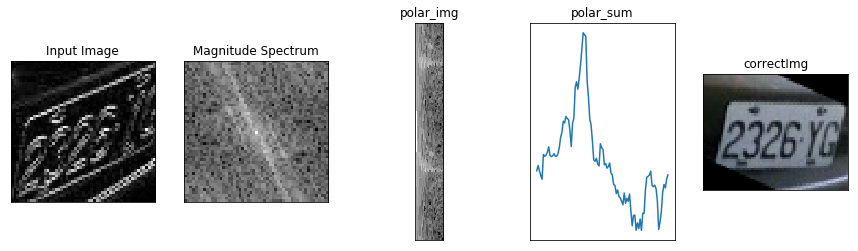

53
(65, 42)
(200, 21)
56


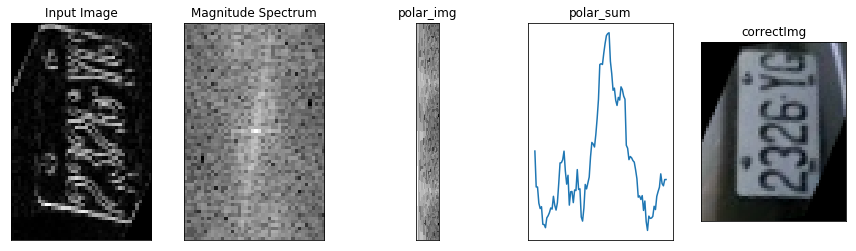

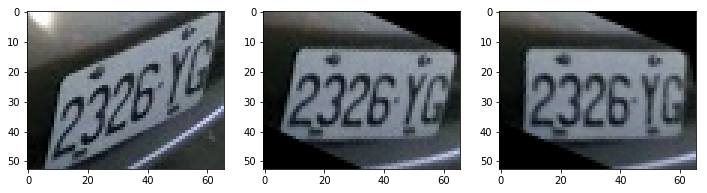

(53, 66, 3)
53
26
img/0_3333X5_1.jpg
51
(46, 40)
(200, 20)
61


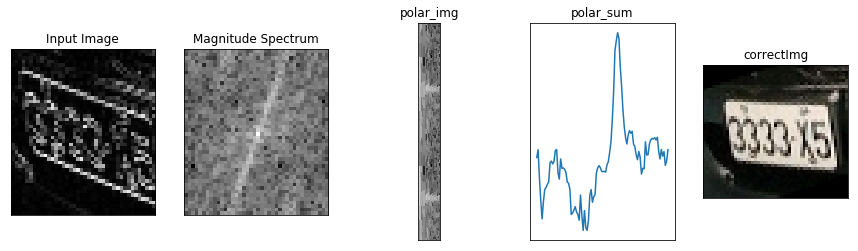

47
(50, 38)
(200, 19)
45


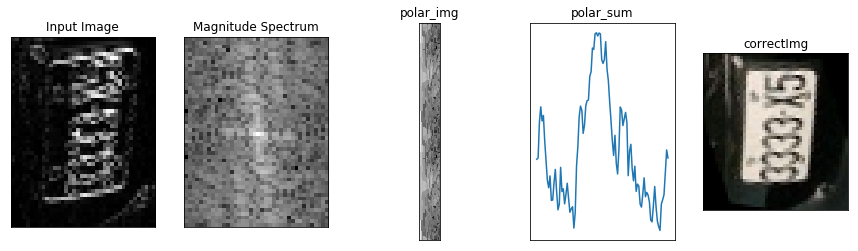

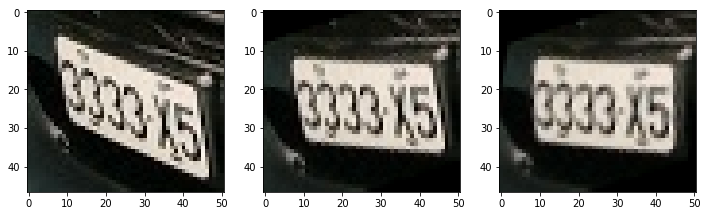

(47, 51, 3)
47
23
img/0_8993QZ_2.jpg
62
(41, 49)
(200, 20)
60


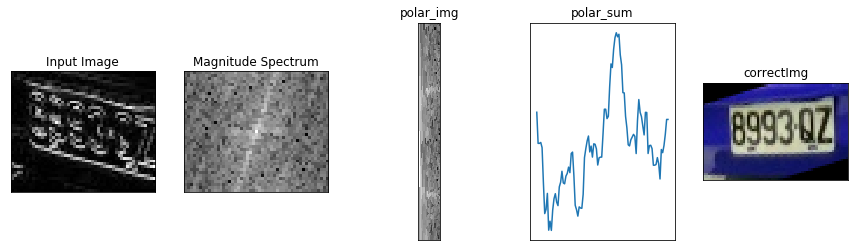

42
(61, 33)
(200, 16)
50


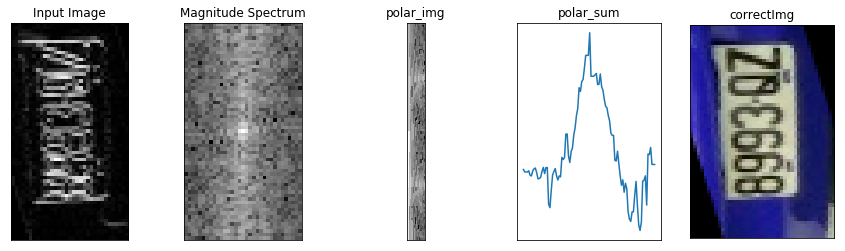

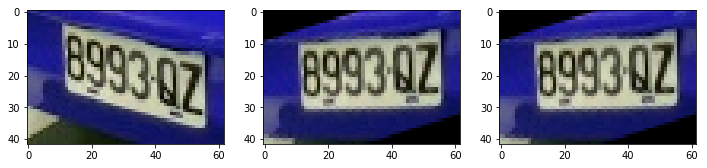

(42, 62, 3)
42
21
img/0_9888X3_3.jpg
134
(111, 107)
(200, 53)
55


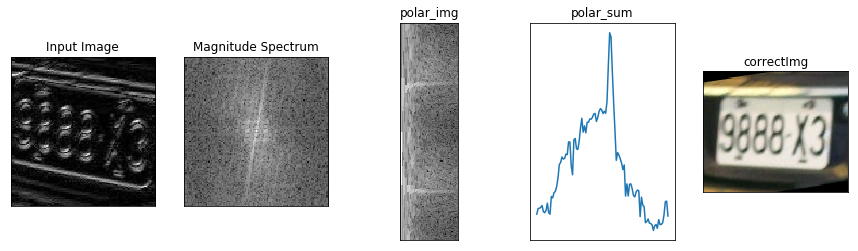

112
(133, 89)
(200, 44)
52


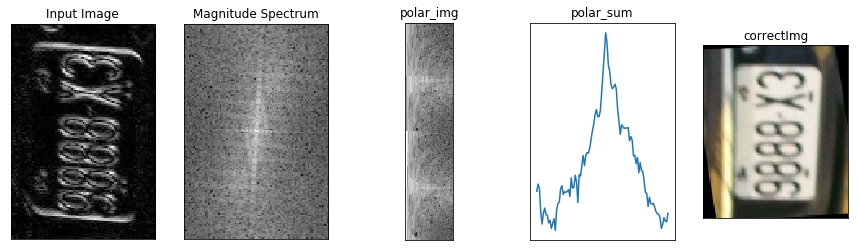

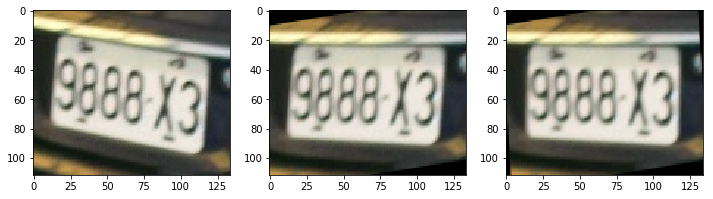

(112, 134, 3)
112
56
img3/RCH3063_1.jpg
156
(139, 125)
(200, 62)
60


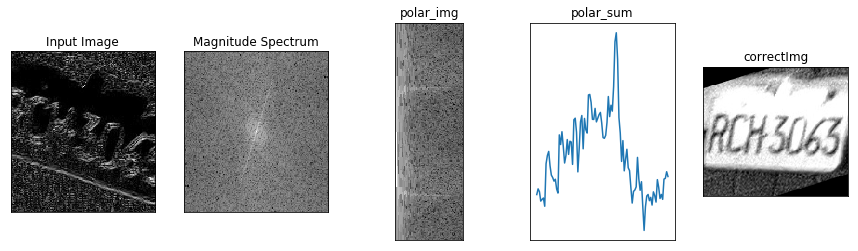

140
(155, 112)
(200, 56)
54


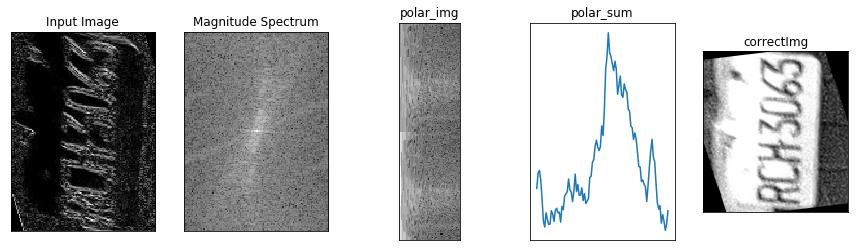

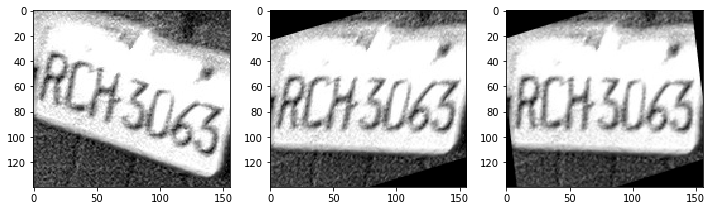

(140, 156, 3)
140
70
img3/KPA0288_3.jpg
168
(87, 135)
(200, 43)
48


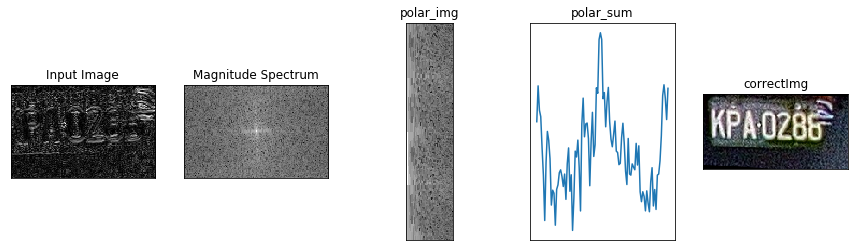

88
(167, 71)
(200, 35)
49


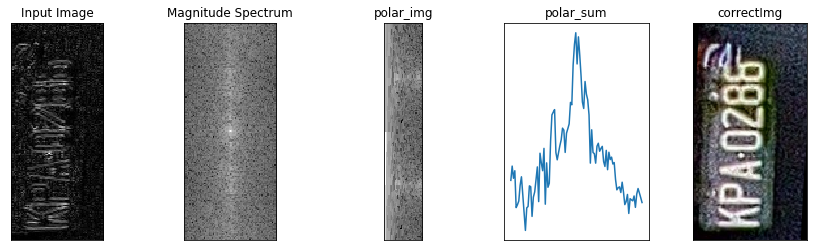

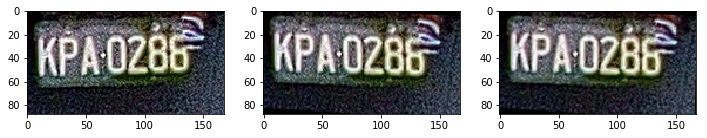

(88, 168, 3)
88
44
img3/3199S9_11.jpg
140
(71, 112)
(200, 35)
50


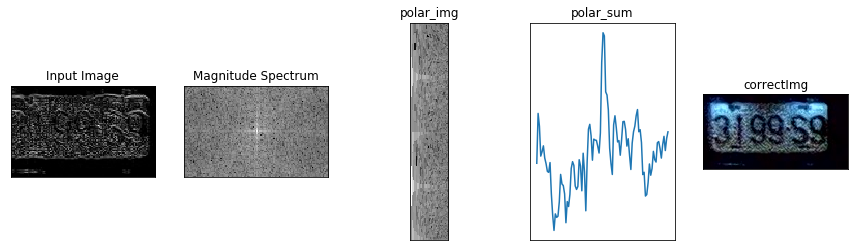

72
(139, 57)
(200, 28)
50


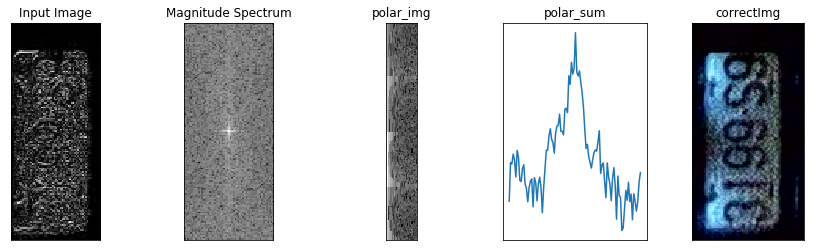

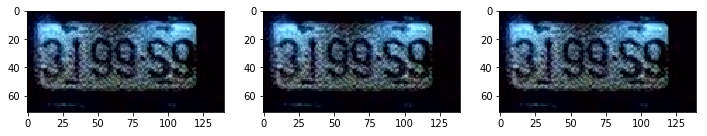

(72, 140, 3)
72
36
img3/KPA0288_7.jpg
176
(87, 141)
(200, 43)
47


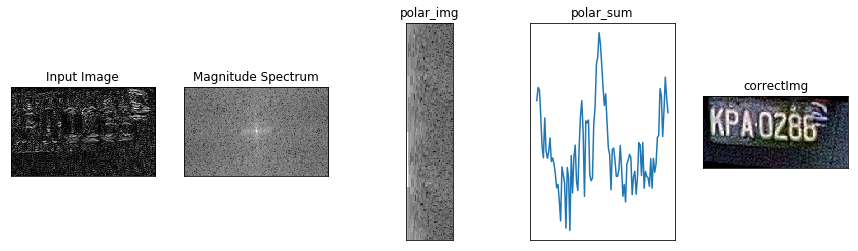

88
(175, 71)
(200, 35)
48


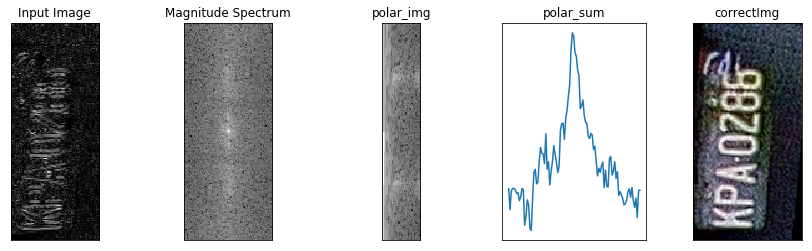

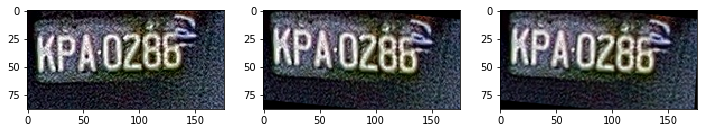

(88, 176, 3)
88
44
img3/3199S9_3.jpg
140
(67, 112)
(200, 33)
50


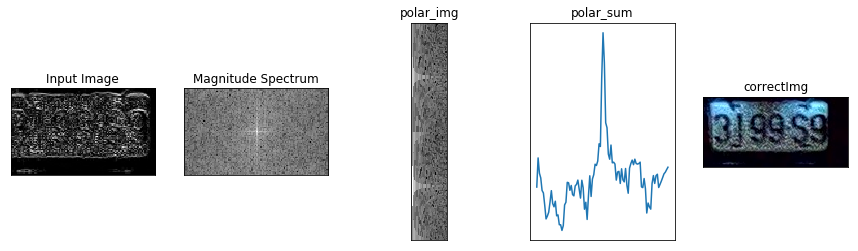

68
(139, 55)
(200, 27)
49


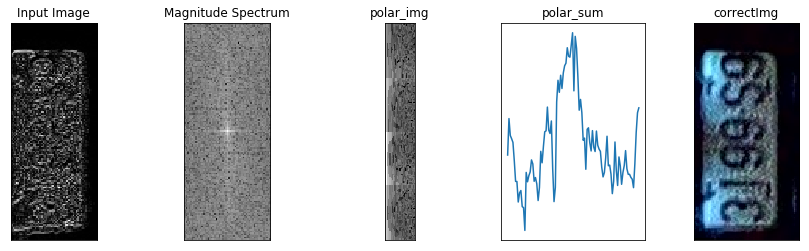

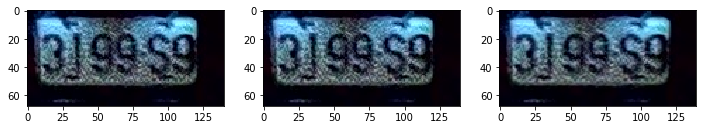

(68, 140, 3)
68
34
img3/3199S9_2.jpg
140
(67, 112)
(200, 33)
50


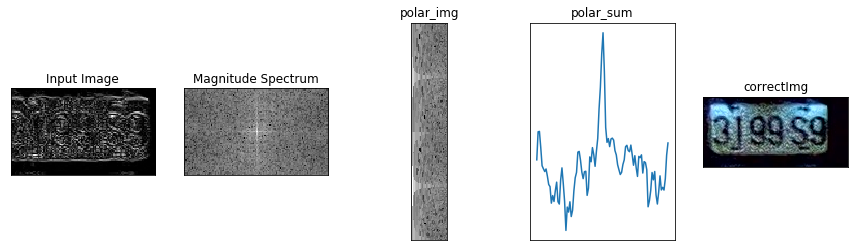

68
(139, 55)
(200, 27)
49


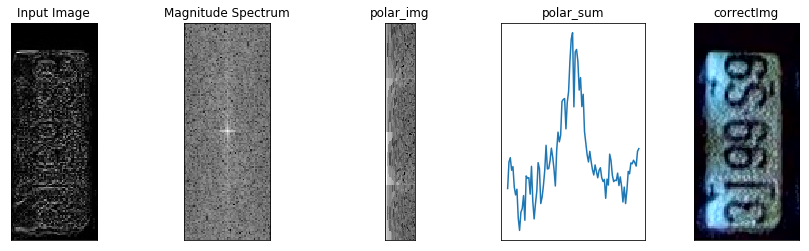

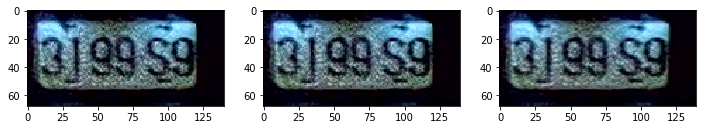

(68, 140, 3)
68
34
img3/KPA0288_4.jpg
176
(87, 141)
(200, 43)
48


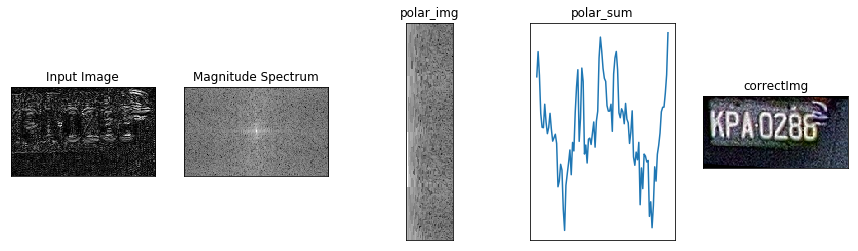

88
(175, 71)
(200, 35)
49


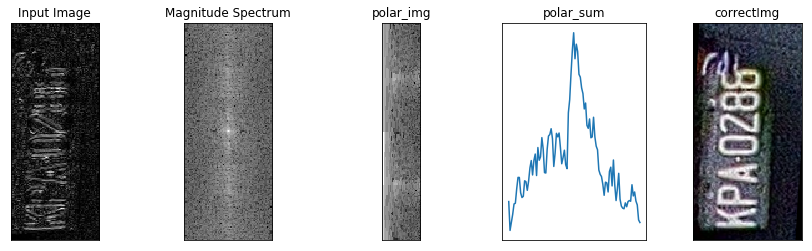

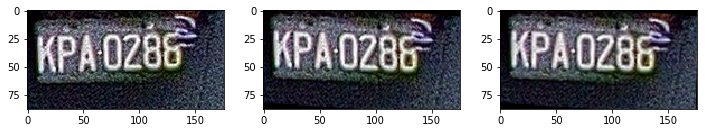

(88, 176, 3)
88
44
img4/MXN1053_1.jpg
108
(87, 87)
(200, 43)
43


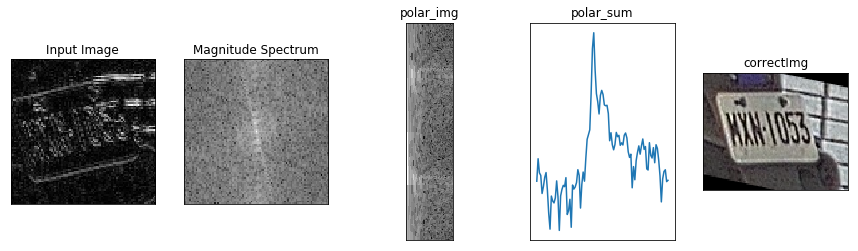

88
(107, 71)
(200, 35)
44


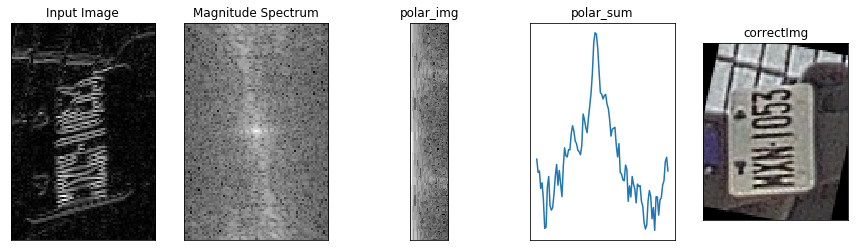

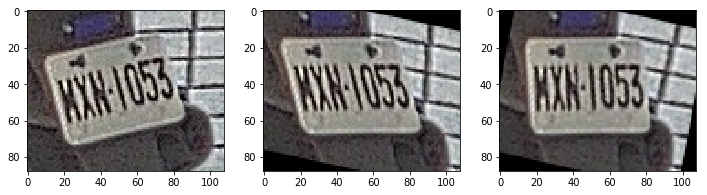

(88, 108, 3)
88
44
img4/APD6995_1.jpg
180
(147, 144)
(200, 72)
62


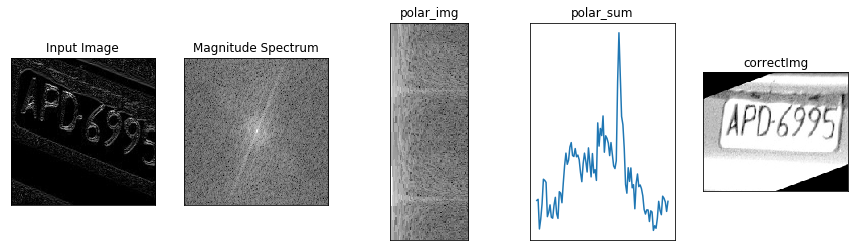

148
(179, 119)
(200, 59)
53


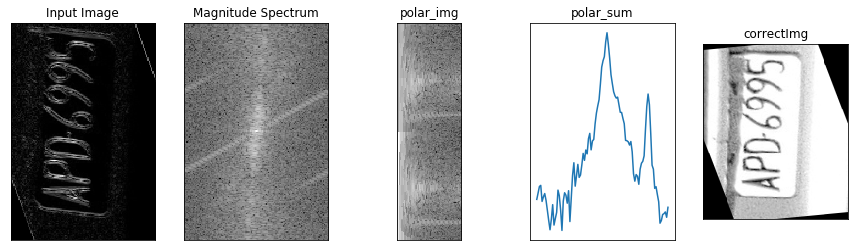

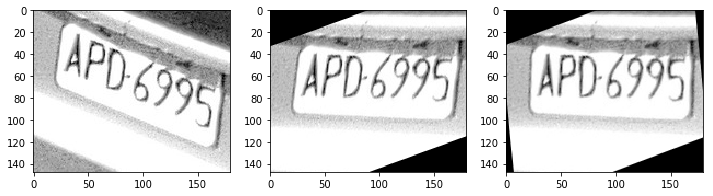

(148, 180, 3)
148
74
img4/MGH9152_1.jpg
120
(103, 96)
(200, 48)
57


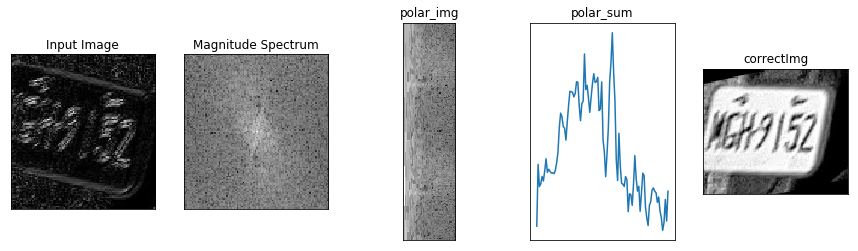

104
(119, 83)
(200, 41)
55


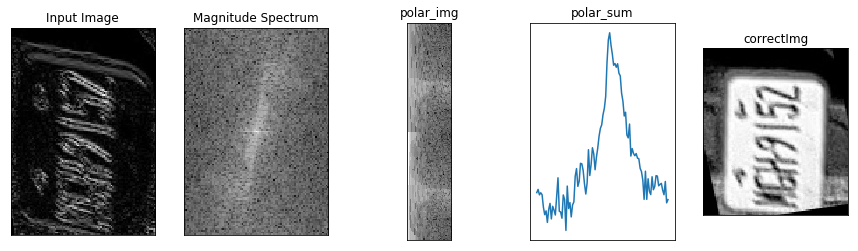

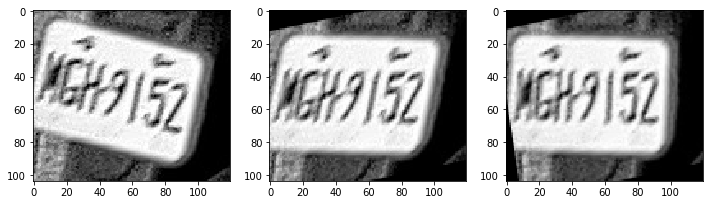

(104, 120, 3)
104
52
img4/5HT591_1.jpg
156
(67, 125)
(200, 33)
50


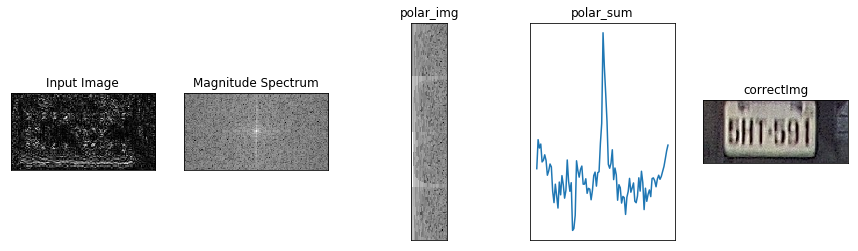

68
(155, 55)
(200, 27)
49


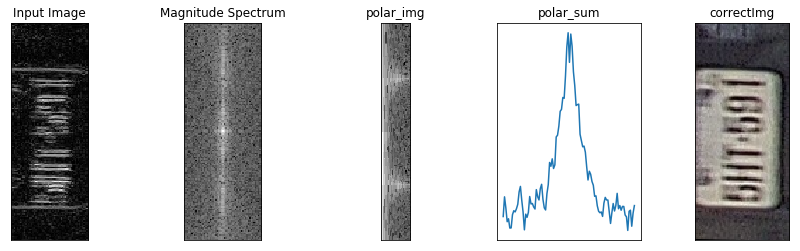

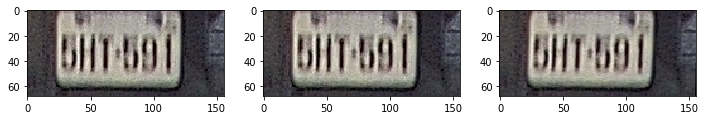

(68, 156, 3)
68
34
img4/PPL931_1.jpg
108
(103, 87)
(200, 43)
58


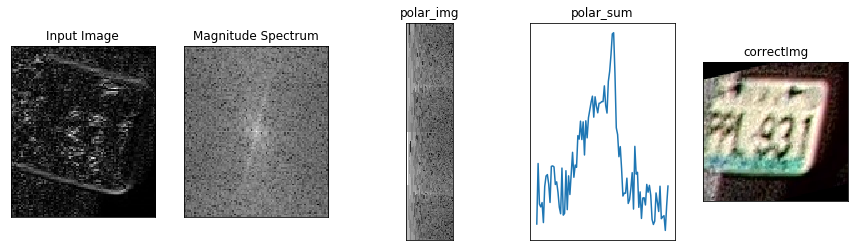

104
(107, 83)
(200, 41)
54


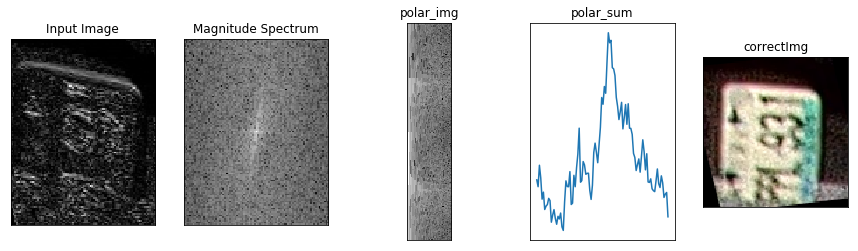

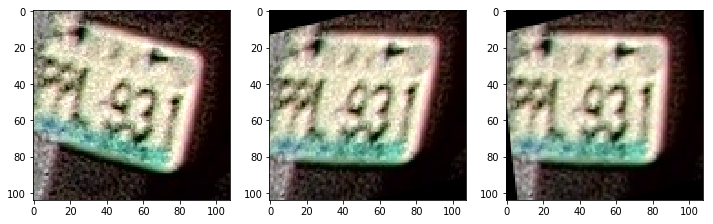

(104, 108, 3)
104
52
img4/HW5815_1.jpg
140
(71, 112)
(200, 35)
53


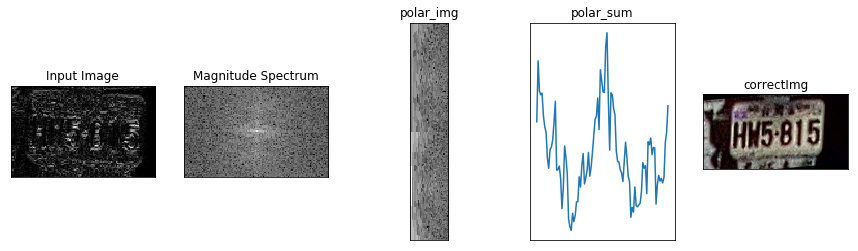

72
(139, 57)
(200, 28)
50


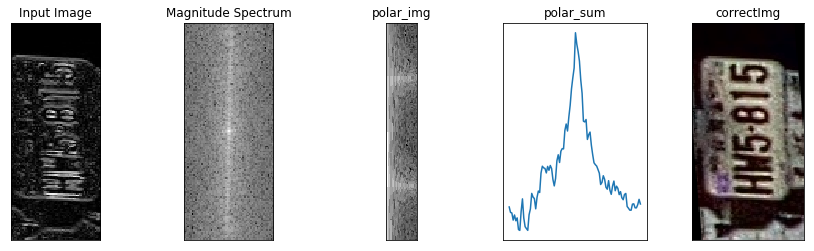

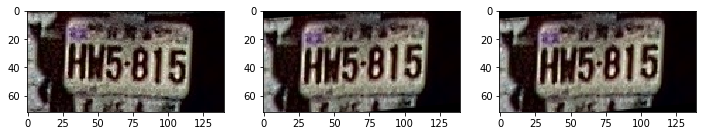

(72, 140, 3)
72
36
img4/TDL8201_2.jpg
188
(111, 151)
(200, 55)
60


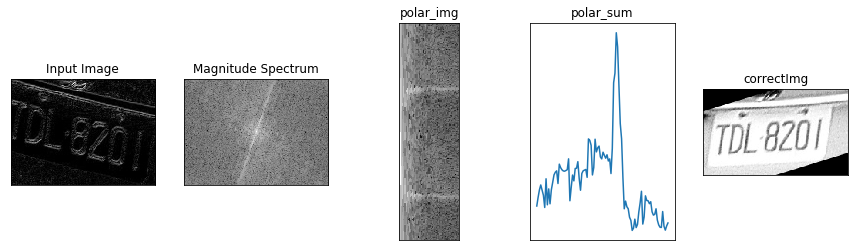

112
(187, 89)
(200, 44)
53


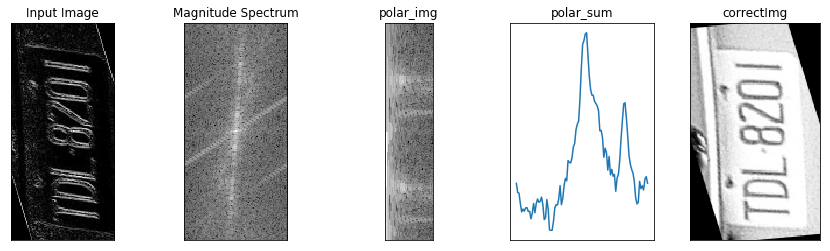

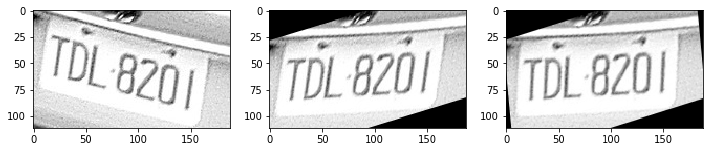

(112, 188, 3)
112
56
img4/PPL931_2.jpg
120
(99, 96)
(200, 48)
58


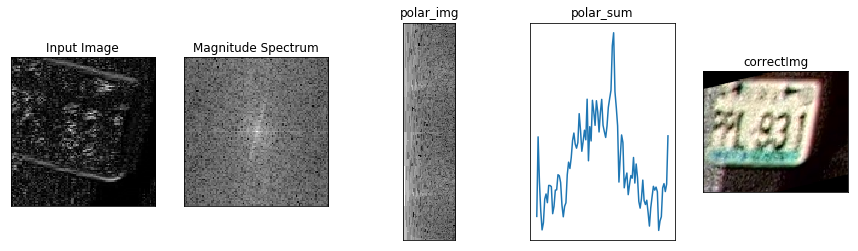

100
(119, 80)
(200, 40)
54


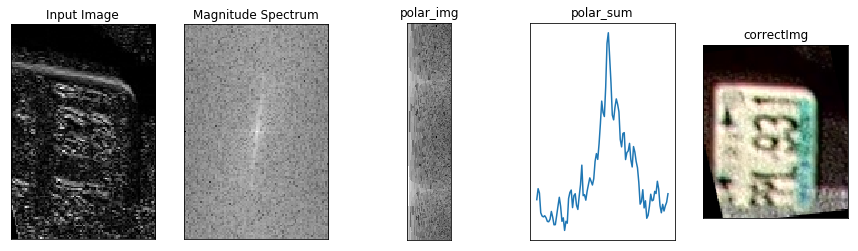

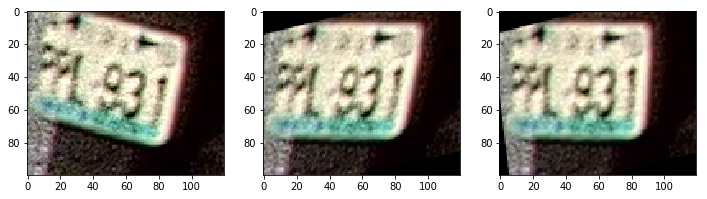

(100, 120, 3)
100
50


In [86]:
import pandas as pd
import os, sys
import numpy as np
import math
from matplotlib import pyplot as plt
from IPython.display import display
from PIL import Image
import PIL
import s3fs 
from sklearn import datasets,linear_model
import cv2
import time

imWrap_t_wrap_t_s=[]
imWrap_t_wrap_t_scaled_s=[]
def rectScale(im):
    print(im.shape)
    myWidth = im.shape[0]
    myHeight = int(myWidth/2)
    print(myWidth)
    print(myHeight)
    nim = cv2.resize(im, (myWidth*2, myHeight*2), interpolation=cv2.INTER_AREA)
    #nim = im.resize((500, 500,3), PIL.Image.ANTIALIAS)
    #nim = im.resize( (myWidth, myHeight), PIL.Image.ANTIALIAS )
    return nim
    

def looAllFFT(path):
    lpRect_s=[]
    pix_gray_s=[]
    imWrap_s=[]
    #imWrap_t_wrap_t_s=[]
    #imWrap_t_wrap_t_scaled_s=[]
    lpCount=0
    cutoffF=0.8
    margin=0.1
    for root,unkown,fNames in os.walk(path):
        for f in fNames:
            lpCount=lpCount+1
            strFpath="{}/{}".format(path,f)
            print(strFpath)
            orgImg = cv2.imread(strFpath)
            pix_color = np.array(orgImg)
            imWrap_t_wrap_t=estCorrect2D(pix_color, cutoffF, margin)
            imWrap_t_wrap_t_scaled=rectScale(imWrap_t_wrap_t)
            #imWrap_t_wrap_t=estCorrect(imWrap_t_wrap_t)
            #print(imWrap_t_wrap_t.shape)
            #plt.imshow(imWrap_t_wrap_t)
            #plt.show()
            imWrap_t_wrap_t_s.append(imWrap_t_wrap_t)
            imWrap_t_wrap_t_scaled_s.append(imWrap_t_wrap_t_scaled)

looAllFFT('img')        
looAllFFT('img3')
looAllFFT('img4')
#%lprun -f looAll('img')


15


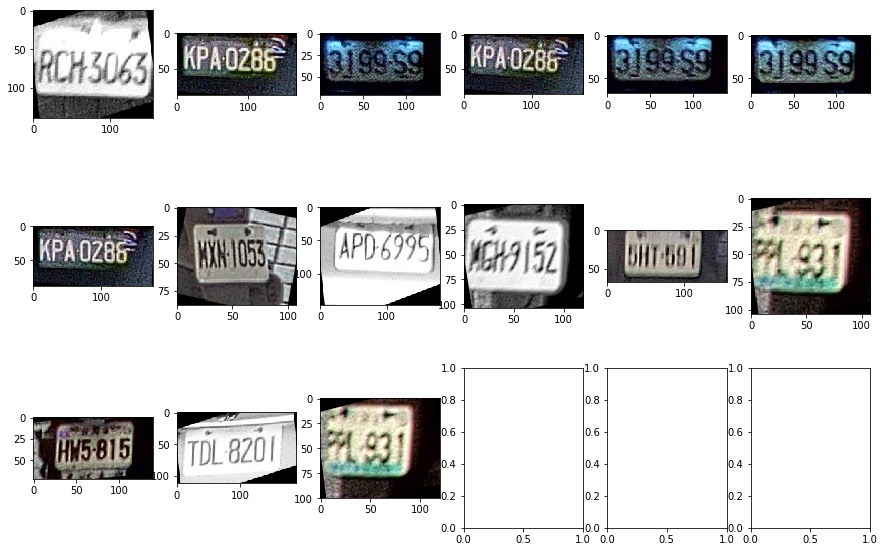

In [85]:
print(len(imWrap_t_wrap_t_s))
#pix_gray_s
plt.subplots(int(len(imWrap_t_wrap_t_s)/6)+1,6,figsize=(15,10))
    
for ii in range(0,len(imWrap_t_wrap_t_s)):
    plt.subplot(int(len(imWrap_t_wrap_t_s)/6)+1,6,ii+1)
    plt.imshow(imWrap_t_wrap_t_s[ii])
    
plt.show()

46


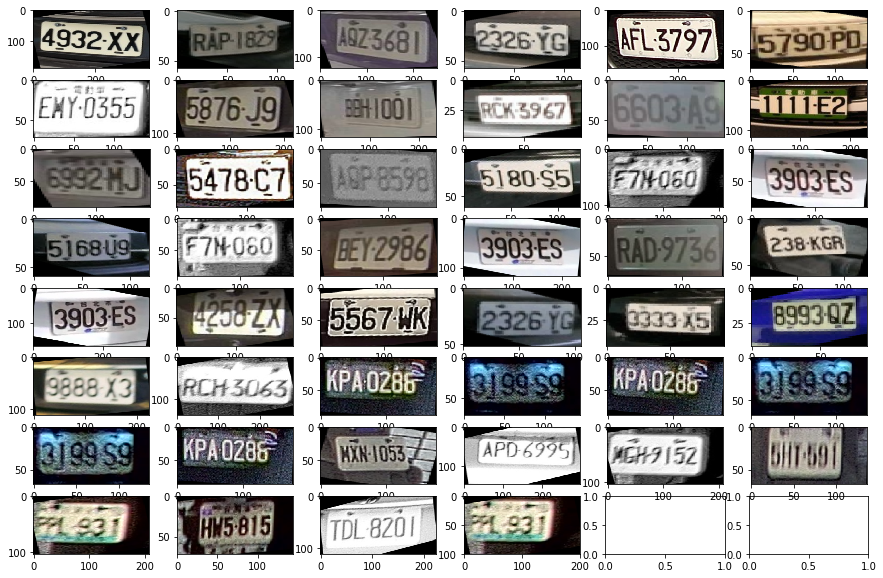

In [87]:
print(len(imWrap_t_wrap_t_scaled_s))
#pix_gray_s
plt.subplots(int(len(imWrap_t_wrap_t_scaled_s)/6)+1,6,figsize=(15,10))
    
for ii in range(0,len(imWrap_t_wrap_t_scaled_s)):
    plt.subplot(int(len(imWrap_t_wrap_t_scaled_s)/6)+1,6,ii+1)
    plt.imshow(imWrap_t_wrap_t_scaled_s[ii])
    
plt.show()

In [88]:
!python fftLPRect.py

55
58
41
25
45
50
50
35
44
34
44
34
50
35
55
58
41
25
45
50
50
35
44
34
44
34
50
35
Figure(1500x1000)


In [28]:
!ls img

0_1111E2_1.jpg	0_4932XX_1.jpg	 0_9888X3_3.jpg   6992mj.jpeg
0_2326YG_1.jpg	0_5168U9_1.jpg	 0_AFL3797_1.jpg  aqz3681.jpeg
0_2326YG_2.jpg	0_5180S5_1.jpg	 0_AQP8598_1.jpg  bbh1001.jpeg
0_238KGR_1.jpg	0_5478C7_1.jpg	 0_RAD9736_1.jpg  bey2986.jpeg
0_3333X5_1.jpg	0_5567WK_1.jpeg  0_RAP1829_2.jpg  EMY0355_2.jpg
0_3903ES_1.jpg	0_5790PD_1.jpg	 0_RCK3967_3.jpg  F7N060_1.jpg
0_3903ES_2.jpg	0_6603A9_1.jpg	 4258zx.jpeg	  F7N060_2.jpg
0_3903ES_3.jpg	0_8993QZ_2.jpg	 5876j9.jpeg
